In [3]:
import torch
print("CUDA:", torch.cuda.is_available())
print("GPU:", torch.cuda.get_device_name(0))

CUDA: True
GPU: NVIDIA H100 80GB HBM3


In [4]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [6]:
print("CUDA:", torch.cuda.is_available())
print("GPU:", torch.cuda.get_device_name(0))

CUDA: True
GPU: NVIDIA H100 80GB HBM3


In [7]:
# =========================
# Cell 1 — Install & Imports
# =========================
import os, math, json, random, re
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
from IPython.display import Video, display

import torch
import torch.nn as nn
from torchvision import transforms
import matplotlib.pyplot as plt

print("OpenCV:", cv2.__version__)
print("PyTorch:", torch.__version__)
print("CUDA available:", torch.cuda.is_available())

# Reproducibility
random.seed(42); np.random.seed(42); torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)

OpenCV: 4.12.0
PyTorch: 2.5.1+cu121
CUDA available: True


In [8]:
# ======================================
# Cell 2 — Scan dataset & build manifest
# ======================================
video_root = './dataset/data/video'
json_root  = './dataset/data/json'

print(f"Video dir exists: {os.path.exists(video_root)}")
print(f"JSON  dir exists: {os.path.exists(json_root)}")

classes   = ['healthy', 'disease']
label_map = {'healthy': 0, 'disease': 1}

dataset_manifest = []
print("\nScanning directories to build dataset manifest...")

for class_name in classes:
    video_class_path = os.path.join(video_root, class_name)
    json_class_path  = os.path.join(json_root,  class_name)

    video_files = [f for f in os.listdir(video_class_path)
                   if f.lower().endswith(('.mp4', '.avi', '.mov'))]

    for video_filename in tqdm(video_files, desc=f"Processing {class_name} videos"):
        video_basename = os.path.splitext(video_filename)[0]
        video_path     = os.path.join(video_class_path, video_filename)
        json_dir_path  = os.path.join(json_class_path,  video_basename)

        if os.path.isdir(json_dir_path):
            json_files = sorted([os.path.join(json_dir_path, f)
                                 for f in os.listdir(json_dir_path) if f.endswith('.json')])
            if json_files:
                dataset_manifest.append({
                    'video_path': video_path,
                    'json_files': json_files,
                    'label':      label_map[class_name],
                    'class_name': class_name
                })
        else:
            print(f"Warning: No matching JSON directory for video: {video_path}")

Video dir exists: True
JSON  dir exists: True

Scanning directories to build dataset manifest...


Processing disease videos: 100%|██████████████████████████████████████████████| 28/28 [00:00<00:00, 73.65it/s]


In [9]:
df = pd.DataFrame(dataset_manifest)
print("\nDataset manifest created.")
print(f"Total samples: {len(df)}")
print("\nHead:\n", df.head())
print("\nClass Distribution:\n", df['class_name'].value_counts())

# Build data_list as (video_path, json_dir, label)
def _json_dir_from_list(json_files):
    if isinstance(json_files, list) and len(json_files) > 0:
        return os.path.dirname(json_files[0])
    return None

data_list = []
for _, row in df.iterrows():
    jd = _json_dir_from_list(row['json_files'])
    if jd is not None:
        data_list.append((row['video_path'], jd, int(row['label'])))

print(f"\ndata_list built with {len(data_list)} samples.")
if len(data_list) > 0:
    print("Example:", data_list[2])


Dataset manifest created.
Total samples: 55

Head:
                                       video_path  \
0  ./dataset/data/video/healthy/v_healthy_24.mp4   
1  ./dataset/data/video/healthy/v_healthy_18.mp4   
2   ./dataset/data/video/healthy/v_healthy_1.mp4   
3   ./dataset/data/video/healthy/v_healthy_4.mp4   
4   ./dataset/data/video/healthy/v_healthy_6.mp4   

                                          json_files  label class_name  
0  [./dataset/data/json/healthy/v_healthy_24/v_he...      0    healthy  
1  [./dataset/data/json/healthy/v_healthy_18/v_he...      0    healthy  
2  [./dataset/data/json/healthy/v_healthy_1/v_hea...      0    healthy  
3  [./dataset/data/json/healthy/v_healthy_4/v_hea...      0    healthy  
4  [./dataset/data/json/healthy/v_healthy_6/v_hea...      0    healthy  

Class Distribution:
 class_name
disease    28
healthy    27
Name: count, dtype: int64

data_list built with 55 samples.
Example: ('./dataset/data/video/healthy/v_healthy_1.mp4', './dataset/data/j

In [10]:
# Pick a sample & show the raw video inline
# --- A) Choose a sample (by index) and display the raw video inline ---
sample_idx = 10  # change this to inspect other samples
video_path, json_dir, label = data_list[sample_idx]
print(f"[SAMPLE] idx={sample_idx}")
print(f"  class label : {label}")
print(f"  video path  : {os.path.normpath(video_path)}")
print(f"  json dir    : {os.path.normpath(json_dir)}")

# Inline player (Jupyter)
try:
    display(Video(video_path, embed=True, width=400))
except Exception as e:
    print("Could not embed video (still OK to continue):", e)

[SAMPLE] idx=10
  class label : 0
  video path  : dataset/data/video/healthy/v_healthy_21.mp4
  json dir    : dataset/data/json/healthy/v_healthy_21


In [11]:
# --- B) Probe video metadata with OpenCV ---
import cv2
cap = cv2.VideoCapture(video_path)
if not cap.isOpened():
    raise RuntimeError(f"Failed to open video: {video_path}")

fps    = cap.get(cv2.CAP_PROP_FPS) or 0.0
nframe = int(cap.get(cv2.CAP_PROP_FRAME_COUNT) or 0)
w      = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH) or 0)
h      = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT) or 0)

fourcc = int(cap.get(cv2.CAP_PROP_FOURCC))
codec  = "".join([chr((fourcc >> 8*i) & 0xFF) for i in range(4)])

duration = (nframe / fps) if fps > 0 else float("nan")

print("\n[VIDEO META]")
print(f"  size      : {w}x{h}")
print(f"  fps       : {fps:.3f}")
print(f"  frames    : {nframe}")
print(f"  duration  : {duration:.2f} sec")
print(f"  codec     : {codec}")
cap.release()


[VIDEO META]
  size      : 1080x1920
  fps       : 30.000
  frames    : 416
  duration  : 13.87 sec
  codec     : h264


In [12]:
# --- C) Extract frames by indices or by stride, with prints ---
import math
import numpy as np
import matplotlib.pyplot as plt

def extract_frames(video_path, indices=None, stride=None, limit=None):
    """
    Returns: list of dicts:
    [{"idx": frame_idx, "time": timestamp_sec, "bgr": np.array(H,W,3)}]
    """
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        raise RuntimeError(f"Failed to open {video_path}")

    fps = cap.get(cv2.CAP_PROP_FPS) or 0.0
    n   = int(cap.get(cv2.CAP_PROP_FRAME_COUNT) or 0)

    # Decide which frames to grab
    if indices is None:
        if stride is None:
            # default: first, middle, last
            indices = [0, n//2, max(0, n-1)]
        else:
            indices = list(range(0, n, stride))
            if limit is not None:
                indices = indices[:limit]

    frames = []
    print("\n[EXTRACT]")
    print(f"  will read {len(indices)} frames: {indices[:10]}{' ...' if len(indices)>10 else ''}")

    for idx in indices:
        if idx < 0 or idx >= n:
            print(f"  - skip idx={idx} (out of range 0..{n-1})")
            continue
        cap.set(cv2.CAP_PROP_POS_FRAMES, idx)
        ok, bgr = cap.read()
        if not ok:
            print(f"  - failed at idx={idx}")
            continue
        t = (idx / fps) if fps > 0 else float("nan")
        print(f"  - got frame idx={idx} @ {t:.3f}s  shape={bgr.shape}")
        frames.append({"idx": idx, "time": t, "bgr": bgr})
    cap.release()
    return frames

# Example 1: first/middle/last
frames_fml = extract_frames(video_path)


[EXTRACT]
  will read 3 frames: [0, 208, 415]
  - got frame idx=0 @ 0.000s  shape=(1920, 1080, 3)
  - got frame idx=208 @ 6.933s  shape=(1920, 1080, 3)
  - got frame idx=415 @ 13.833s  shape=(1920, 1080, 3)


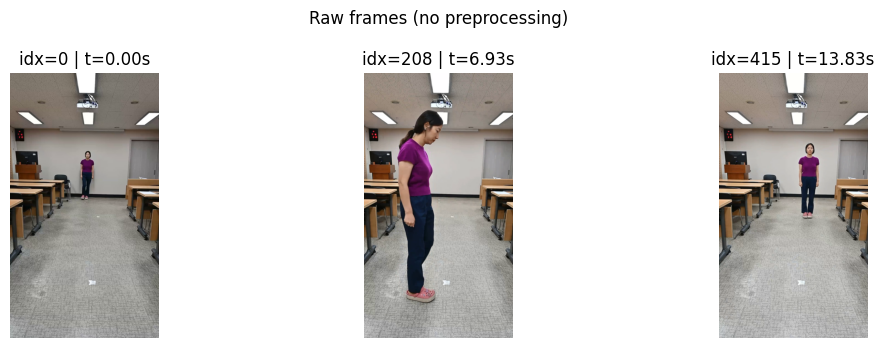

In [13]:
# --- D) Show extracted frames ---
def show_frames(frames, title="Frames (raw)"):
    if not frames:
        print("No frames to show.")
        return
    cols = min(3, len(frames))
    rows = math.ceil(len(frames)/cols)
    plt.figure(figsize=(4*cols, 3.5*rows))
    for i, f in enumerate(frames, 1):
        # OpenCV is BGR; matplotlib expects RGB
        rgb = cv2.cvtColor(f["bgr"], cv2.COLOR_BGR2RGB)
        plt.subplot(rows, cols, i)
        plt.imshow(rgb)
        plt.axis("off")
        plt.title(f"idx={f['idx']} | t={f['time']:.2f}s")
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

show_frames(frames_fml, title="Raw frames (no preprocessing)")


[POSE] Found 416 JSONs in: ./dataset/data/json/healthy/v_healthy_21
  - frame 0: overlay using v_healthy_21_000000000000_keypoints.json
  - frame 208: overlay using v_healthy_21_000000000208_keypoints.json
  - frame 415: overlay using v_healthy_21_000000000415_keypoints.json


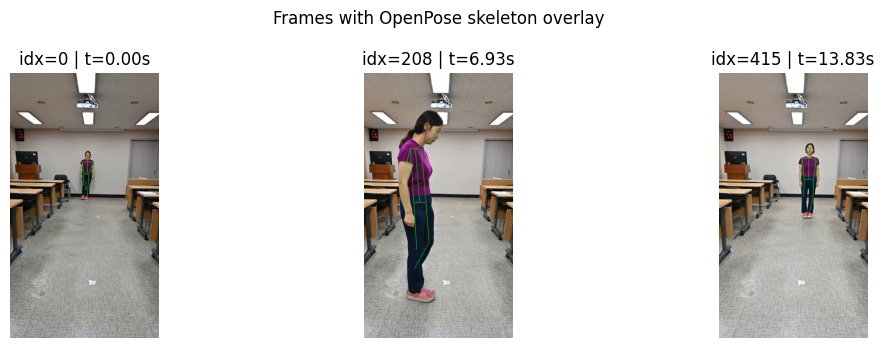

In [14]:
# --- E) Draw OpenPose skeletons if JSONs exist ---
import json
import glob
import os

# Skeleton definitions
COCO18_PAIRS = [
    (0,1),(1,2),(2,3),(3,4),      # Nose->Neck->RShoulder->RElbow->RWrist
    (1,5),(5,6),(6,7),            # Neck->LShoulder->LElbow->LWrist
    (1,8),(8,9),(9,10),           # Neck->MidHip->RKnee->RAnkle
    (8,12),(12,13),(13,14),       # MidHip->LHip->LKnee->LAnkle
    (0,15),(15,17),               # Nose->REye->REar
    (0,16),(16,18)                # Nose->LEye->LEar
]
BODY25_PAIRS = [
    (0,1),(1,2),(2,3),(3,4),      # Nose->Neck->RShoulder->RElbow->RWrist
    (1,5),(5,6),(6,7),            # Neck->LShoulder->LElbow->LWrist
    (1,8),(8,9),(9,10),           # Neck->MidHip->RKnee->RAnkle
    (8,12),(12,13),(13,14),       # MidHip->LHip->LKnee->LAnkle
    (0,15),(15,17),               # Nose->REye->REar
    (0,16),(16,18),               # Nose->LEye->LEar
    (2,9),(5,12)                  # Shoulders to hips (common extra links)
]

def load_keypoints(json_path):
    with open(json_path, "r") as f:
        data = json.load(f)
    people = data.get("people", [])
    if not people:
        return None, None
    # prefer first person
    p = people[0]
    # OpenPose can store 'pose_keypoints_2d' or 'pose_keypoints'
    k = p.get("pose_keypoints_2d") or p.get("pose_keypoints")
    if not k:
        return None, None
    arr = np.array(k, dtype=np.float32).reshape(-1, 3)  # (N, 3) -> x,y,conf
    N = arr.shape[0]
    if N == 25:
        pairs = BODY25_PAIRS
        fmt   = "BODY_25"
    elif N == 18:
        pairs = COCO18_PAIRS
        fmt   = "COCO_18"
    else:
        pairs = []
        fmt   = f"Unknown({N})"
    return arr, pairs

def draw_skeleton(bgr, kpts, pairs, point_radius=3):
    img = bgr.copy()
    if kpts is None or pairs is None:
        return img
    # draw bones
    for a,b in pairs:
        xa,ya,ca = kpts[a]
        xb,yb,cb = kpts[b]
        if ca>0.05 and cb>0.05:
            cv2.line(img, (int(xa),int(ya)), (int(xb),int(yb)), (0,255,0), 2)
    # draw joints
    for x,y,c in kpts:
        if c>0.05:
            cv2.circle(img, (int(x),int(y)), point_radius, (0,0,255), -1)
    return img

# map frames->jsons by sorted order (your filenames are already zero-padded)
json_files_sorted = sorted(glob.glob(os.path.join(json_dir, "*.json")))
print(f"\n[POSE] Found {len(json_files_sorted)} JSONs in: {json_dir}")

# overlay on the frames we extracted
overlay_frames = []
for f in frames_fml:
    idx = f["idx"]
    if idx < len(json_files_sorted):
        jp = json_files_sorted[idx]
        kpts, pairs = load_keypoints(jp)
        if kpts is None:
            print(f"  - frame {idx}: no people detected in {os.path.basename(jp)}")
            overlay_frames.append({"idx": idx, "time": f["time"], "bgr": f["bgr"]})
        else:
            img = draw_skeleton(f["bgr"], kpts, pairs)
            print(f"  - frame {idx}: overlay using {os.path.basename(jp)}")
            overlay_frames.append({"idx": idx, "time": f["time"], "bgr": img})
    else:
        print(f"  - frame {idx}: no matching JSON (idx >= {len(json_files_sorted)})")
        overlay_frames.append({"idx": idx, "time": f["time"], "bgr": f["bgr"]})

show_frames(overlay_frames, title="Frames with OpenPose skeleton overlay")

In [15]:
#re running transform cell before running the the framing
import torchvision.transforms.functional as F
from torchvision import transforms

class ResizeSquarePad224:
    def __call__(self, img):  # img: PIL
        w, h = img.size
        s = 224 / max(w, h)
        new_w, new_h = int(round(w*s)), int(round(h*s))
        img = F.resize(img, (new_h, new_w), antialias=True)
        pad_left  = (224 - new_w) // 2
        pad_top   = (224 - new_h) // 2
        pad_right = 224 - new_w - pad_left
        pad_bottom= 224 - new_h - pad_top
        img = F.pad(img, [pad_left, pad_top, pad_right, pad_bottom], fill=0)
        img._resizepad_meta = dict(scale=s, pad_left=pad_left, pad_top=pad_top)
        return img

frame_transform = transforms.Compose([
    transforms.ToPILImage(),
    ResizeSquarePad224(),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225]),
])

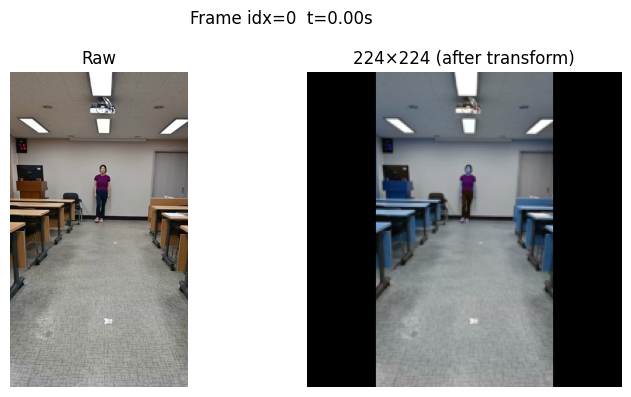

In [16]:
# --- F) Show raw vs. transformed (224x224) ---
imagenet_mean = np.array([0.485, 0.456, 0.406], dtype=np.float32)
imagenet_std  = np.array([0.229, 0.224, 0.225], dtype=np.float32)

def apply_transform_preview(bgr, transform):
    # to PIL -> resize -> tensor -> normalize (C,H,W)
    x = transform(bgr)
    # denormalize for visualization
    x_np = x.numpy().transpose(1,2,0)  # H,W,C
    x_np = (x_np * imagenet_std) + imagenet_mean
    x_np = np.clip(x_np, 0, 1)
    return (x_np * 255).astype(np.uint8)  # back to 0..255

if frames_fml:
    raw = cv2.cvtColor(frames_fml[0]["bgr"], cv2.COLOR_BGR2RGB)
    resized = apply_transform_preview(frames_fml[0]["bgr"], frame_transform)
    plt.figure(figsize=(8,4))
    plt.subplot(1,2,1); plt.imshow(raw);    plt.title("Raw");     plt.axis("off")
    plt.subplot(1,2,2); plt.imshow(resized); plt.title("224×224 (after transform)"); plt.axis("off")
    plt.suptitle(f"Frame idx={frames_fml[0]['idx']}  t={frames_fml[0]['time']:.2f}s")
    plt.tight_layout(); plt.show()

In [17]:
#Pick a sample and gather basics
import glob, json, math
import numpy as np
import matplotlib.pyplot as plt
import cv2, os

# pick a sample to inspect
sample_idx = 0    # change as needed
video_path, json_dir, label = data_list[sample_idx]
print(f"SAMPLE {sample_idx}\n video : {video_path}\n json  : {json_dir}\n label : {label}")

# video meta
cap = cv2.VideoCapture(video_path)
assert cap.isOpened(), f"Cannot open {video_path}"
fps    = cap.get(cv2.CAP_PROP_FPS) or 0.0
nframe = int(cap.get(cv2.CAP_PROP_FRAME_COUNT) or 0)
W      = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH) or 0)
H      = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT) or 0)
cap.release()
print(f"Video meta: {W}x{H}, {fps:.2f} fps, {nframe} frames")

# list JSONs
json_files = sorted(glob.glob(os.path.join(json_dir, "*.json")))
print(f"JSON files: {len(json_files)} found")

SAMPLE 0
 video : ./dataset/data/video/healthy/v_healthy_24.mp4
 json  : ./dataset/data/json/healthy/v_healthy_24
 label : 0
Video meta: 1080x1920, 30.08 fps, 365 frames
JSON files: 365 found


Frames with JSON: 365 / 365


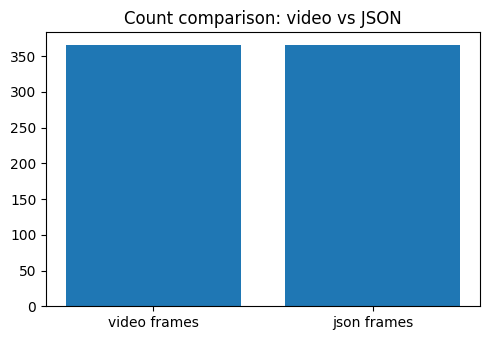

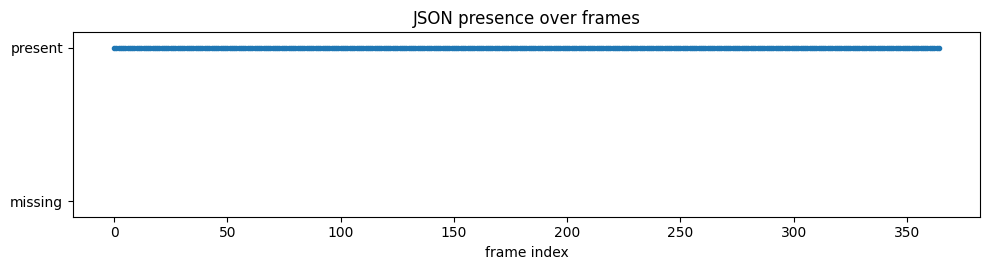

In [18]:
# build a presence vector per frame: 1 if JSON exists, else 0
present = np.zeros(nframe, dtype=np.int32)

# try to infer frame index from file order (your filenames are zero-padded in order)
# we assume json_files[i] corresponds to frame i (common with OpenPose batch export)
for i in range(min(len(json_files), nframe)):
    present[i] = 1

print(f"Frames with JSON: {present.sum()} / {nframe}")

# 1) bar: total frames vs json frames
plt.figure(figsize=(5,3.5))
plt.bar(["video frames", "json frames"], [nframe, int(present.sum())])
plt.title("Count comparison: video vs JSON")
plt.tight_layout(); plt.show()

# 2) missing-map across timeline (1=has json, 0=missing)
plt.figure(figsize=(10,2.8))
plt.plot(present, marker='.', linestyle='none')
plt.ylim(-0.1, 1.1); plt.yticks([0,1], ["missing","present"])
plt.xlabel("frame index"); plt.title("JSON presence over frames")
plt.tight_layout(); plt.show()

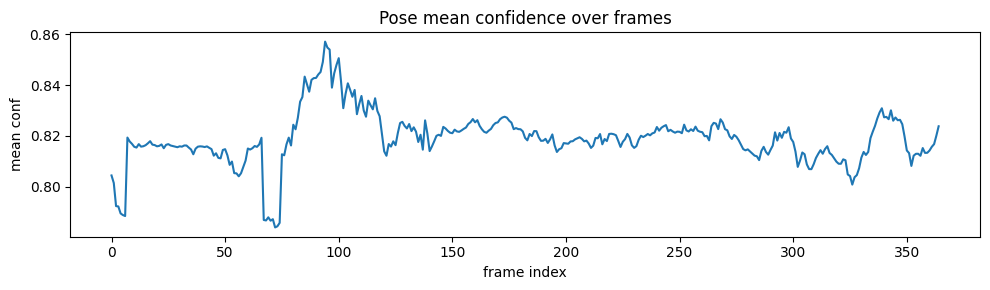

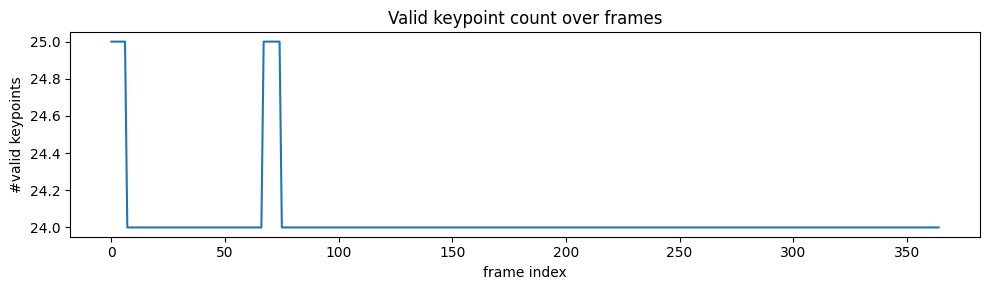

In [19]:
#Pose quality over time (mean conf & valid keypoints)
def load_keypoints(json_path):
    with open(json_path, "r") as f:
        data = json.load(f)
    people = data.get("people", [])
    if not people:
        return None
    p = people[0]
    k = p.get("pose_keypoints_2d") or p.get("pose_keypoints")
    if k is None: 
        return None
    pts = np.array(k, dtype=np.float32).reshape(-1, 3)  # (N, 3): x,y,conf
    return pts

# compute mean confidence & valid count per frame with JSON
mean_conf = np.full(nframe, np.nan, dtype=np.float32)
valid_cnt = np.zeros(nframe, dtype=np.int32)

for i in range(min(len(json_files), nframe)):
    pts = load_keypoints(json_files[i])
    if pts is None:
        continue
    conf = pts[:, 2]
    valid = conf > 0.05
    mean_conf[i] = conf[valid].mean() if valid.any() else np.nan
    valid_cnt[i] = int(valid.sum())

# plots
xs = np.arange(nframe)

plt.figure(figsize=(10,3))
plt.plot(xs, mean_conf)
plt.title("Pose mean confidence over frames")
plt.xlabel("frame index"); plt.ylabel("mean conf")
plt.tight_layout(); plt.show()

plt.figure(figsize=(10,3))
plt.plot(xs, valid_cnt)
plt.title("Valid keypoint count over frames")
plt.xlabel("frame index"); plt.ylabel("#valid keypoints")
plt.tight_layout(); plt.show()

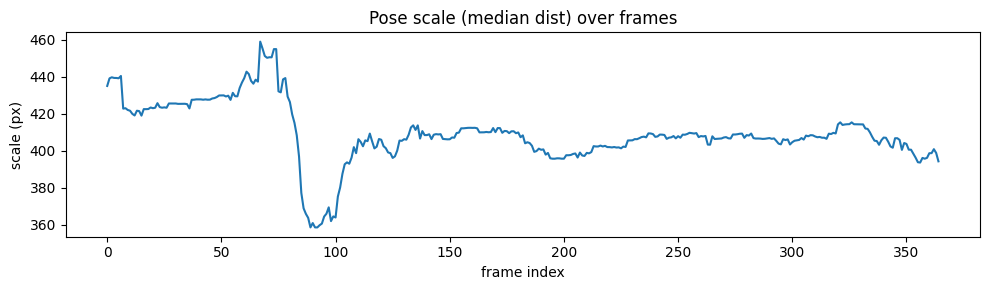

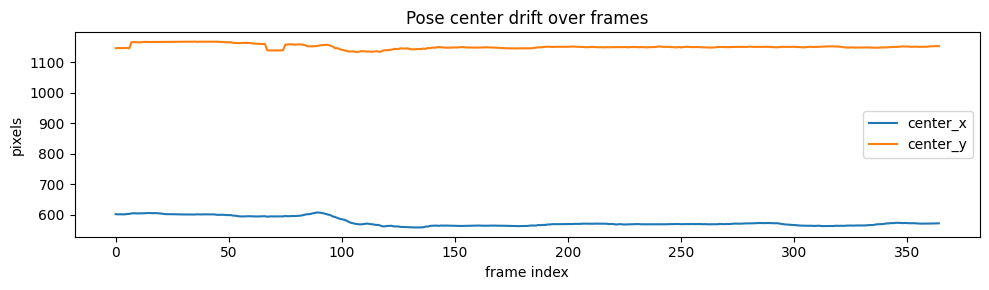

In [20]:
#Geometric sanity (scale & center drift)
def pose_center_scale(pts):
    conf = pts[:,2]
    m = conf > 0.05
    if not np.any(m): 
        return None, None
    xy = pts[m,:2]
    center = xy.mean(axis=0)
    # robust "scale": median distance to center
    d = np.sqrt(((xy - center)**2).sum(axis=1))
    scale = np.median(d)
    return center, scale

centers = np.full((nframe,2), np.nan, dtype=np.float32)
scales  = np.full(nframe, np.nan, dtype=np.float32)

for i in range(min(len(json_files), nframe)):
    pts = load_keypoints(json_files[i])
    if pts is None: continue
    c, s = pose_center_scale(pts)
    if c is None: continue
    centers[i] = c
    scales[i]  = s

plt.figure(figsize=(10,3))
plt.plot(scales)
plt.title("Pose scale (median dist) over frames")
plt.xlabel("frame index"); plt.ylabel("scale (px)")
plt.tight_layout(); plt.show()

plt.figure(figsize=(10,3))
plt.plot(centers[:,0], label="center_x")
plt.plot(centers[:,1], label="center_y")
plt.title("Pose center drift over frames")
plt.xlabel("frame index"); plt.ylabel("pixels")
plt.legend(); plt.tight_layout(); plt.show()

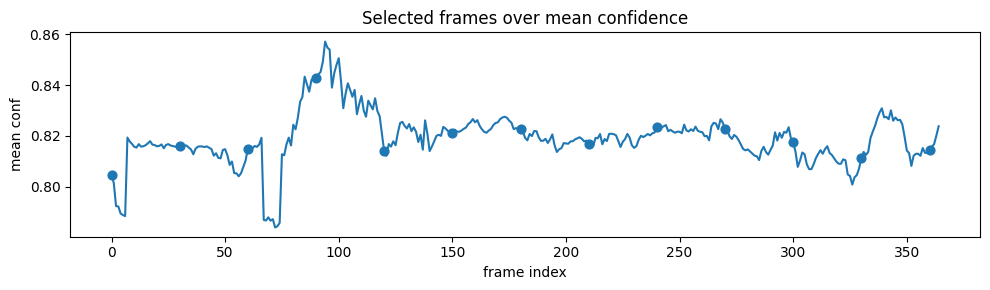

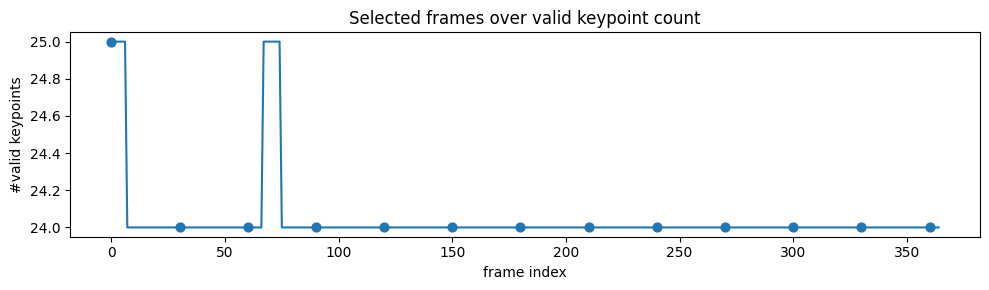

In [21]:
#Audit your selection strategy
# choose a selection rule
stride = 30
chosen = np.arange(0, nframe, stride)

# mark on mean confidence plot
plt.figure(figsize=(10,3))
plt.plot(xs, mean_conf)
mask = chosen[(chosen < nframe)]
plt.scatter(mask, mean_conf[mask], s=40)
plt.title("Selected frames over mean confidence")
plt.xlabel("frame index"); plt.ylabel("mean conf")
plt.tight_layout(); plt.show()

# mark on valid keypoints plot
plt.figure(figsize=(10,3))
plt.plot(xs, valid_cnt)
plt.scatter(mask, valid_cnt[mask], s=40)
plt.title("Selected frames over valid keypoint count")
plt.xlabel("frame index"); plt.ylabel("#valid keypoints")
plt.tight_layout(); plt.show()

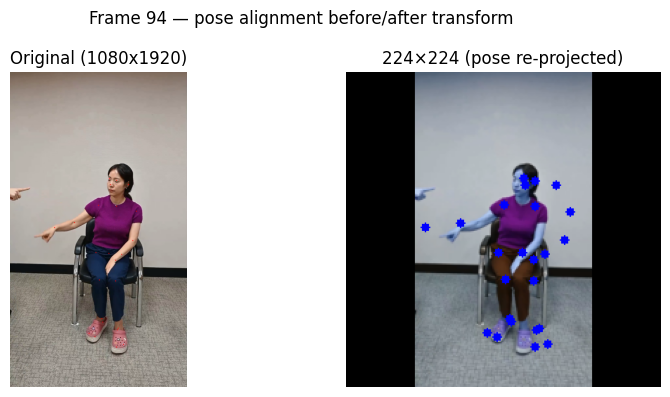

In [22]:
#Before vs After transform: keypoint re-projection check
# helper to get a single frame (BGR)
def read_frame(video_path, idx):
    cap = cv2.VideoCapture(video_path)
    cap.set(cv2.CAP_PROP_POS_FRAMES, idx)
    ok, bgr = cap.read()
    cap.release()
    return bgr if ok else None

# choose a frame that has JSON
test_idx = int(np.nanargmax(np.where(~np.isnan(mean_conf), mean_conf, -1)))
bgr = read_frame(video_path, test_idx)
pts = load_keypoints(json_files[test_idx]) if test_idx < len(json_files) else None
assert bgr is not None and pts is not None, "Need a valid frame+pose"

H0, W0 = bgr.shape[:2]

# 1) draw on original
orig = bgr.copy()
for (x,y,c) in pts:
    if c > 0.05:
        cv2.circle(orig, (int(x),int(y)), 3, (0,0,255), -1)

# 2) transform image to 224×224
x_t = frame_transform(bgr)               # tensor [3,224,224], normalized
img_224 = x_t.numpy().transpose(1,2,0)   # H,W,C in normalized space
# de-normalize for display
mn = np.array([0.485,0.456,0.406], dtype=np.float32)
sd = np.array([0.229,0.224,0.225], dtype=np.float32)
img_224 = (img_224*sd + mn).clip(0,1)
img_224 = (img_224*255).astype(np.uint8)

# 3) scale keypoints to 224×224 and draw
scale_x = 224.0 / W0
scale_y = 224.0 / H0
proj = img_224.copy()
for (x,y,c) in pts:
    if c > 0.05:
        xx = int(x*scale_x); yy = int(y*scale_y)
        cv2.circle(proj, (xx,yy), 3, (0,0,255), -1)

# show side-by-side
plt.figure(figsize=(9,4))
plt.subplot(1,2,1); plt.imshow(cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)); plt.axis("off"); plt.title(f"Original ({W0}x{H0})")
plt.subplot(1,2,2); plt.imshow(proj); plt.axis("off"); plt.title("224×224 (pose re-projected)")
plt.suptitle(f"Frame {test_idx} — pose alignment before/after transform")
plt.tight_layout(); plt.show()

In [23]:
#person-aware crop (best quality, a bit more work)
def bbox_from_keypoints(pts, conf_thr=0.05, margin=0.15, W0=None, H0=None):
    m = pts[:,2] > conf_thr
    xy = pts[m,:2]
    if xy.size == 0:  # fallback to full frame
        return 0,0,W0,H0
    x1,y1 = xy.min(0)
    x2,y2 = xy.max(0)
    # add margin
    w = x2-x1; h = y2-y1
    x1 -= w*margin; y1 -= h*margin
    x2 += w*margin; y2 += h*margin
    # clamp
    x1 = max(0, x1); y1 = max(0, y1)
    x2 = min(W0-1, x2); y2 = min(H0-1, y2)
    return int(x1), int(y1), int(x2), int(y2)

In [24]:
idx = 100   # choose a frame index
bgr = read_frame(video_path, idx)  # from your helper
H0, W0 = bgr.shape[:2]
pts = load_keypoints(json_files[idx])

In [25]:
x1, y1, x2, y2 = bbox_from_keypoints(pts, W0=W0, H0=H0)
print("Bounding box:", (x1, y1, x2, y2))

Bounding box: (196, 487, 815, 1849)


In [26]:
# crop the image
crop = bgr[y1:y2, x1:x2]

# adjust keypoints (shift them relative to crop)
pts_crop = pts.copy()
pts_crop[:,0] -= x1
pts_crop[:,1] -= y1

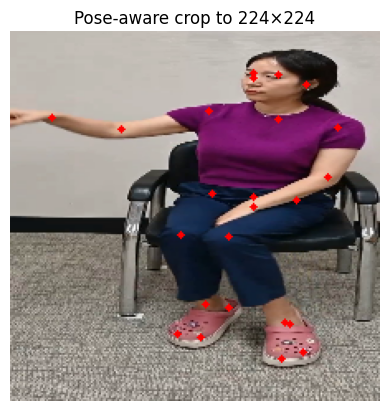

In [27]:
crop_resized = cv2.resize(crop, (224,224))

# scale keypoints accordingly
sx = 224.0 / (x2 - x1)
sy = 224.0 / (y2 - y1)
pts_resized = pts_crop.copy()
pts_resized[:,0] *= sx
pts_resized[:,1] *= sy

vis = crop_resized.copy()
for (x,y,c) in pts_resized:
    if c > 0.05:
        cv2.circle(vis, (int(x),int(y)), 2, (0,0,255), -1)

plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
plt.title("Pose-aware crop to 224×224")
plt.axis("off")
plt.show()

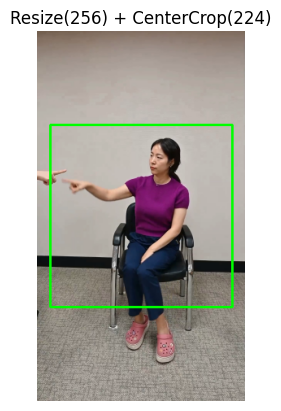

In [28]:
# compute the crop rectangle in the resized image
H0, W0 = bgr.shape[:2]
if H0 < W0:
    s = 256.0 / H0; H1=256; W1=int(round(W0*s))
else:
    s = 256.0 / W0; W1=256; H1=int(round(H0*s))
off_x = (W1 - 224) // 2
off_y = (H1 - 224) // 2

# show crop on resized image
resized = cv2.resize(bgr, (W1, H1), interpolation=cv2.INTER_AREA)
vis = resized.copy()
cv2.rectangle(vis, (off_x, off_y), (off_x+224, off_y+224), (0,255,0), 2)
plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB)); plt.axis('off'); plt.title("Resize(256) + CenterCrop(224)"); plt.show()

In [29]:
from PIL import Image
import torchvision.transforms.functional as F
from torchvision import transforms

class ResizeSquarePad224:
    def __call__(self, img: Image.Image):
        w, h = img.size
        s = 224 / max(w, h)
        new_w, new_h = int(round(w*s)), int(round(h*s))
        img = F.resize(img, (new_h, new_w), antialias=True)
        pad_left  = (224 - new_w) // 2
        pad_top   = (224 - new_h) // 2
        pad_right = 224 - new_w - pad_left
        pad_bottom= 224 - new_h - pad_top
        img = F.pad(img, [pad_left, pad_top, pad_right, pad_bottom], fill=0)
        # attach meta so we can map keypoints later
        img._resizepad_meta = dict(scale=s, pad_left=pad_left, pad_top=pad_top,
                                   new_w=new_w, new_h=new_h)
        return img

# define the "post" transforms (that don't destroy meta)
to_tensor_norm = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225]),
])

In [30]:
# read a BGR frame, convert to RGB
cap = cv2.VideoCapture(video_path)
ok, bgr = cap.read(); cap.release()
assert ok, "couldn't read a frame"
rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

# 1) letterbox to 224 (PIL) and collect meta
letterbox = ResizeSquarePad224()
pil_224 = letterbox(Image.fromarray(rgb))
meta = pil_224._resizepad_meta  # <-- keep this!

# 2) finish transform
x = to_tensor_norm(pil_224)     # tensor [3,224,224]

In [31]:
s        = meta["scale"]
pad_left = meta["pad_left"]
pad_top  = meta["pad_top"]

x224 = x * s + pad_left
y224 = y * s + pad_top

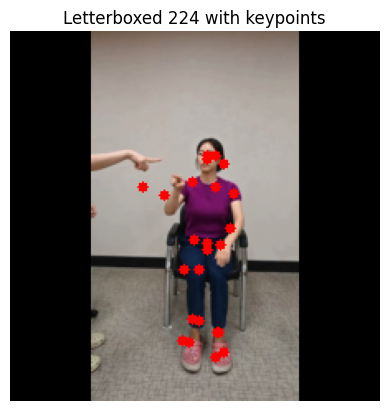

In [32]:
# draw on 224 image (denormalize just for viewing)
img224 = np.array(pil_224)  # already 224x224 RGB uint8
for (x,y,c) in pts:
    if c > 0.05:
        xx = int(x * s + pad_left)
        yy = int(y * s + pad_top)
        cv2.circle(img224, (xx,yy), 3, (255,0,0), -1)
plt.imshow(img224); plt.axis("off"); plt.title("Letterboxed 224 with keypoints"); plt.show()

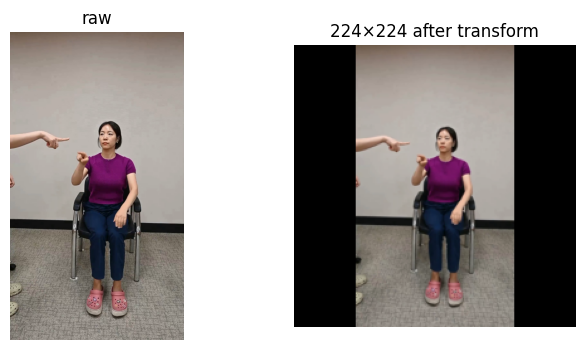

In [33]:
#sanity-check visualization (before vs after)
rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
x = frame_transform(rgb)                         # [3,224,224]
viz = (x.permute(1,2,0).numpy()*[0.229,0.224,0.225] + [0.485,0.456,0.406])
viz = np.clip(viz, 0, 1)

plt.figure(figsize=(8,4))
plt.subplot(1,2,1); plt.imshow(rgb); plt.title("raw"); plt.axis("off")
plt.subplot(1,2,2); plt.imshow((viz*255).astype(np.uint8)); plt.title("224×224 after transform"); plt.axis("off")
plt.show()

In [34]:
# start dymanic frames instead of making it static
def extract_video_frames(video_path, num_frames=None, start=0, device=None):
    """
    Extract frames from a video and optionally move them to GPU.

    Args:
        video_path (str): Path to video file.
        num_frames (int or None):
            - If int → sample that many frames uniformly across the whole video.
            - If None → extract all frames.
        start (int): Starting frame index.
        device (torch.device or str or None):
            - 'cuda', 'cpu', or torch.device.
            - If None → auto-detect.
    Returns:
        torch.Tensor of shape (T, 3, 224, 224) on selected device.
    """
    # Auto-detect device
    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    cap = cv2.VideoCapture(video_path)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    if total_frames == 0:
        print(f"⚠️  Warning: no frames in {video_path}")
        cap.release()
        return None

    # Decide which frames to read
    if num_frames is None or num_frames >= total_frames:
        frame_indices = list(range(start, total_frames))
    else:
        interval = max(total_frames // num_frames, 1)
        frame_indices = list(range(start, total_frames, interval))[:num_frames]

    selected_frames = []

    for i in frame_indices:
        cap.set(cv2.CAP_PROP_POS_FRAMES, i)
        ret, frame = cap.read()
        if not ret:
            break

        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frame_tensor = frame_transform(frame_rgb)  # Should return (3,224,224)
        selected_frames.append(frame_tensor)

    cap.release()

    if len(selected_frames) == 0:
        return None

    # Stack and move to chosen device
    batch = torch.stack(selected_frames).to(device)
    return batch


In [35]:
# Dynamically extract frames from the entire video
batch = extract_video_frames(video_path, num_frames=None)

if batch is not None:
    print(f"Extracted {batch.shape[0]} frames.")
    print("Batch shape:", tuple(batch.shape))
    print("Dtype:", batch.dtype)
    print("Device:", batch.device)
    print("GPU Available:", torch.cuda.is_available())

Extracted 365 frames.
Batch shape: (365, 3, 224, 224)
Dtype: torch.float32
Device: cuda:0
GPU Available: True


In [36]:
for i, (video_path, _, label) in enumerate(data_list):
    print(f"\n[{i}] {video_path} (label={label})")
    
    # Dynamically extract all frames (or you can pass num_frames=None for full extraction)
    frames = extract_video_frames(video_path, num_frames=None)
    
    if frames is None:
        print("   ❌ No frames extracted!")
        continue

    total_frames = frames.shape[0]
    print(f"   ✅ Extracted {total_frames} frames — Shape: {tuple(frames.shape)}")

    # Optional: For long videos, show just a few stats for sanity check
    if total_frames > 200:
        print("   ⚠️ Long video detected, only showing first and last frame preview indices.")
    else:
        print("   Frame indices covered: 0 →", total_frames - 1)



[0] ./dataset/data/video/healthy/v_healthy_24.mp4 (label=0)
   ✅ Extracted 365 frames — Shape: (365, 3, 224, 224)
   ⚠️ Long video detected, only showing first and last frame preview indices.

[1] ./dataset/data/video/healthy/v_healthy_18.mp4 (label=0)
   ✅ Extracted 176 frames — Shape: (176, 3, 224, 224)
   Frame indices covered: 0 → 175

[2] ./dataset/data/video/healthy/v_healthy_1.mp4 (label=0)
   ✅ Extracted 1029 frames — Shape: (1029, 3, 224, 224)
   ⚠️ Long video detected, only showing first and last frame preview indices.

[3] ./dataset/data/video/healthy/v_healthy_4.mp4 (label=0)
   ✅ Extracted 728 frames — Shape: (728, 3, 224, 224)
   ⚠️ Long video detected, only showing first and last frame preview indices.

[4] ./dataset/data/video/healthy/v_healthy_6.mp4 (label=0)
   ✅ Extracted 275 frames — Shape: (275, 3, 224, 224)
   ⚠️ Long video detected, only showing first and last frame preview indices.

[5] ./dataset/data/video/healthy/v_healthy_23.mp4 (label=0)
   ✅ Extracted 756 

In [37]:
def extract_pose_sequence(json_folder, num_frames=None, start=0, debug=True):
    """
    Dynamically extract pose keypoints from OpenPose JSON files.

    Args:
        json_folder (str): Directory containing JSON files.
        num_frames (int or None): 
            - If int → sample that many frames uniformly across available JSONs.
            - If None → load all available JSONs.
        start (int): starting index (for chunked reading).
        debug (bool): whether to print progress info.

    Returns:
        torch.Tensor: (T, 25, 2) pose sequence.
    """
    json_files = sorted([f for f in os.listdir(json_folder) if f.endswith('.json')])
    total = len(json_files)

    if debug:
        print(f"\n[POSE] Folder: {json_folder}")
        print(f"  Found {total} JSON files")

    if total == 0:
        if debug:
            print("  ⚠️ No JSON files found — returning empty tensor.")
        return torch.zeros((1, 25, 2), dtype=torch.float32)

    # Determine indices dynamically
    if num_frames is None or num_frames >= total:
        selected_files = json_files[start:total]  # all available JSONs
    else:
        interval = max(total // num_frames, 1)
        selected_files = json_files[start::interval][:num_frames]

    pose_sequence = []

    for i, file in enumerate(selected_files):
        path = os.path.join(json_folder, file)
        try:
            with open(path, 'r') as f:
                data = json.load(f)
            people = data.get("people", [])
            if not people:
                pose = np.zeros((25, 2))
                if debug:
                    print(f"  Frame {i}: {file} → empty (no person detected)")
            else:
                keypoints = people[0]["pose_keypoints_2d"]
                keypoints = np.array(keypoints).reshape(25, 3)[:, :2]  # keep (x,y)
                pose = keypoints
                if debug:
                    print(f"  Frame {i}: {file} → pose shape {pose.shape}, sample pt0={pose[0]}")
        except Exception as e:
            pose = np.zeros((25, 2))
            if debug:
                print(f"  Frame {i}: {file} → error: {e}")
        pose_sequence.append(pose)

    pose_tensor = torch.tensor(pose_sequence, dtype=torch.float32)  # (T,25,2)

    if debug:
        print(f"  ✅ Final tensor shape: {pose_tensor.shape}")
        print(f"  Value range: {pose_tensor.min().item()} → {pose_tensor.max().item()}")

    return pose_tensor


In [38]:
# Dynamically extract all pose keypoints
pose_seq = extract_pose_sequence(json_dir, num_frames=None, debug=True)

print("\n[CHECK]")
print("Pose sequence shape:", pose_seq.shape)   # (T,25,2)

# Check first frame’s first 5 joints for verification
if pose_seq.shape[0] > 0:
    print("First frame, first 5 joints:\n", pose_seq[0, :5])
else:
    print("No valid pose data found.")



[POSE] Folder: ./dataset/data/json/healthy/v_healthy_24
  Found 365 JSON files
  Frame 0: v_healthy_24_000000000000_keypoints.json → pose shape (25, 2), sample pt0=[597.594 650.152]
  Frame 1: v_healthy_24_000000000001_keypoints.json → pose shape (25, 2), sample pt0=[597.658 650.169]
  Frame 2: v_healthy_24_000000000002_keypoints.json → pose shape (25, 2), sample pt0=[597.616 650.129]
  Frame 3: v_healthy_24_000000000003_keypoints.json → pose shape (25, 2), sample pt0=[597.623 650.104]
  Frame 4: v_healthy_24_000000000004_keypoints.json → pose shape (25, 2), sample pt0=[597.686 650.19 ]
  Frame 5: v_healthy_24_000000000005_keypoints.json → pose shape (25, 2), sample pt0=[602.57  650.186]
  Frame 6: v_healthy_24_000000000006_keypoints.json → pose shape (25, 2), sample pt0=[597.719 650.186]
  Frame 7: v_healthy_24_000000000007_keypoints.json → pose shape (25, 2), sample pt0=[602.588 650.281]
  Frame 8: v_healthy_24_000000000008_keypoints.json → pose shape (25, 2), sample pt0=[602.688 65

/tmp/ipykernel_217878/3220266511.py:59: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)
  pose_tensor = torch.tensor(pose_sequence, dtype=torch.float32)  # (T,25,2)


In [39]:
# ======================================
# Cell 4 — Encoders (ViT, GRU) + Fusion
# ======================================
from torchvision.models import vit_b_16
try:
    from torchvision.models import ViT_B_16_Weights
    _weights = ViT_B_16_Weights.DEFAULT
    def _make_vit():
        m = vit_b_16(weights=_weights)
        m.heads = nn.Identity()
        return m
except Exception:
    def _make_vit():
        m = vit_b_16(pretrained=True)
        m.heads = nn.Identity()
        return m

class ViTEncoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.vit = _make_vit()
        for p in self.vit.parameters():
            p.requires_grad = False  # freeze

    def forward(self, x):  # (B,3,224,224)
        with torch.no_grad():
            feats = self.vit(x)     # (B,768)
        return feats

In [40]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# 1) Create encoder
encoder = ViTEncoder().to(device)
encoder.eval()

# 2) Get total frame count
cap = cv2.VideoCapture(video_path)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
cap.release()
print(f"Total frames in video: {total_frames}")

# 3) Process all frames in chunks of 16
batch_size = 16
all_feats = []

for start in range(0, total_frames, batch_size):
    end = min(start + batch_size, total_frames)
    
    # Extract 16 consecutive frames (or fewer for the last chunk)
    frames = extract_video_frames(video_path, start=start, num_frames=end - start)
    if frames is None or len(frames) == 0:
        continue

    # Move to GPU and flatten (B,T,C,H,W → (B*T,C,H,W))
    frames = frames.to(device)
    B, T, C, H, W = 1, frames.shape[0], frames.shape[1], frames.shape[2], frames.shape[3]
    frames_flat = frames.view(B*T, C, H, W)

    # Encode this chunk
    with torch.no_grad():
        feats = encoder(frames_flat)       # (T,768)
        feats = feats.view(B, T, -1)       # (1,T,768)
        all_feats.append(feats.cpu())

# 4) Combine all chunks into a single tensor
if len(all_feats) > 0:
    video_feats = torch.cat(all_feats, dim=1)   # (1,total_frames,768)
    print("✅ Video features extracted:", video_feats.shape)
else:
    print("⚠️ No features extracted (check video path or frames).")

Using device: cuda
Total frames in video: 128
✅ Video features extracted: torch.Size([1, 72, 768])


In [41]:
class PoseEncoderGRU(nn.Module):
    def __init__(self, input_size=50, hidden_size=128, num_layers=1):
        super().__init__()
        self.gru = nn.GRU(input_size=input_size, hidden_size=hidden_size,
                          num_layers=num_layers, batch_first=True)

    def forward(self, x):  # (B,T,50)
        out, _ = self.gru(x)  # (B,T,hidden)
        return out

In [42]:
# 1) Extract all pose frames dynamically
pose_seq = extract_pose_sequence(json_dir, num_frames=None, debug=True)   # (T,25,2)

if pose_seq is None or pose_seq.shape[0] == 0:
    print("⚠️ No pose data extracted.")
else:
    T = pose_seq.shape[0]
    print(f"✅ Loaded {T} pose frames.")

    # 2) Flatten joints to (T,50)
    pose_flat = pose_seq.reshape(T, -1)        # (T,50)

    # 3) Add batch dimension
    pose_batch = pose_flat.unsqueeze(0).to(device)   # (1,T,50)

    # 4) Encode with GRU
    pose_encoder = PoseEncoderGRU(input_size=50, hidden_size=128).to(device)
    pose_encoder.eval()
    with torch.no_grad():
        feats = pose_encoder(pose_batch)             # (1,T,128)

    print("✅ Pose features extracted:", feats.shape)



[POSE] Folder: ./dataset/data/json/healthy/v_healthy_24
  Found 365 JSON files
  Frame 0: v_healthy_24_000000000000_keypoints.json → pose shape (25, 2), sample pt0=[597.594 650.152]
  Frame 1: v_healthy_24_000000000001_keypoints.json → pose shape (25, 2), sample pt0=[597.658 650.169]
  Frame 2: v_healthy_24_000000000002_keypoints.json → pose shape (25, 2), sample pt0=[597.616 650.129]
  Frame 3: v_healthy_24_000000000003_keypoints.json → pose shape (25, 2), sample pt0=[597.623 650.104]
  Frame 4: v_healthy_24_000000000004_keypoints.json → pose shape (25, 2), sample pt0=[597.686 650.19 ]
  Frame 5: v_healthy_24_000000000005_keypoints.json → pose shape (25, 2), sample pt0=[602.57  650.186]
  Frame 6: v_healthy_24_000000000006_keypoints.json → pose shape (25, 2), sample pt0=[597.719 650.186]
  Frame 7: v_healthy_24_000000000007_keypoints.json → pose shape (25, 2), sample pt0=[602.588 650.281]
  Frame 8: v_healthy_24_000000000008_keypoints.json → pose shape (25, 2), sample pt0=[602.688 65

In [43]:
import torch
import torch.nn as nn
import numpy as np

class TokenFusionLayerStrict(nn.Module):
    """
    Strict fusion to match your finalized setup:
      - inputs:  visual (T,768) or (B,T,768), pose (T,128) or (B,T,128)
      - project both -> fusion_dim
      - add, LayerNorm, Dropout
      - returns: (B,T,fusion_dim)  (B=1 if inputs were 2D)
    """
    def __init__(self, visual_dim=768, pose_dim=128, fusion_dim=512, dropout=0.1, debug=True):
        super().__init__()
        self.visual_proj = nn.Linear(visual_dim, fusion_dim)
        self.pose_proj   = nn.Linear(pose_dim, fusion_dim)
        self.norm        = nn.LayerNorm(fusion_dim)
        self.dropout     = nn.Dropout(dropout)
        self.debug       = debug

    def forward(self, visual_tokens, pose_tokens):
        v, p = visual_tokens, pose_tokens

        # ✅ Ensure 3D shapes (B,T,D)
        if v.dim() == 2: v = v.unsqueeze(0)
        if p.dim() == 2: p = p.unsqueeze(0)

        # ✅ Automatically fix small time mismatches (±1–2 frames)
        if v.shape[1] != p.shape[1]:
            min_T = min(v.shape[1], p.shape[1])
            if self.debug:
                print(f"⚠️ [Auto-trim] visual={v.shape[1]}, pose={p.shape[1]} → using {min_T}")
            v = v[:, :min_T, :]
            p = p[:, :min_T, :]

        # ✅ Batch dimension check (should always match)
        assert v.shape[0] == p.shape[0], f"Batch mismatch: visual {v.shape}, pose {p.shape}"

        if self.debug:
            print(f"[Fusion] inputs   visual={tuple(v.shape)}  pose={tuple(p.shape)}")

        # Projection
        v_proj = self.visual_proj(v)   # (B,T,fusion_dim)
        p_proj = self.pose_proj(p)     # (B,T,fusion_dim)

        if self.debug:
            print(f"[Fusion] project  v_proj={tuple(v_proj.shape)}  p_proj={tuple(p_proj.shape)}")
            print(f"[Fusion] samples  v_proj[0,0,:5]={np.array2string(v_proj[0,0,:5].detach().cpu().numpy(), precision=3)}")
            print(f"[Fusion] samples  p_proj[0,0,:5]={np.array2string(p_proj[0,0,:5].detach().cpu().numpy(), precision=3)}")

        # Fusion
        fused = self.dropout(self.norm(v_proj + p_proj))  # (B,T,fusion_dim)

        if self.debug:
            print(f"[Fusion] output   fused={tuple(fused.shape)} "
                  f"fused[0,0,:5]={np.array2string(fused[0,0,:5].detach().cpu().numpy(), precision=3)}")

        return fused


In [44]:
import matplotlib.pyplot as plt

def fuse_and_inspect(fusion_layer, visual_tokens, pose_tokens, title="Fusion diagnostics"):
    """
    - Runs the fusion layer once (no grads) and prints shapes/ranges.
    - Plots:
        1) L2 norms over time for v_proj, p_proj, fused
        2) Cosine similarity between v_proj and p_proj over time
        3) Histogram of fused activations
    - Inputs can be (T,D) or (B,T,D).
    - Returns: fused (B,T,fusion_dim)
    """
    # Prepare shapes
    v = visual_tokens
    p = pose_tokens
    if v.dim() == 2: v = v.unsqueeze(0)
    if p.dim() == 2: p = p.unsqueeze(0)

    # Forward pass (and keep intermediates using the layer’s submodules)
    fusion_layer_was = fusion_layer.debug
    fusion_layer.debug = True  # ensure we see prints once

    with torch.no_grad():
        v_proj = fusion_layer.visual_proj(v)
        p_proj = fusion_layer.pose_proj(p)
        fused  = fusion_layer.dropout(fusion_layer.norm(v_proj + p_proj))

    # Print shapes and simple stats
    print("\n[Inspect] Shapes:")
    print("  visual_tokens :", tuple(visual_tokens.shape))
    print("  pose_tokens   :", tuple(pose_tokens.shape))
    print("  v_proj        :", tuple(v_proj.shape))
    print("  p_proj        :", tuple(p_proj.shape))
    print("  fused         :", tuple(fused.shape))

    def stats(name, x):
        x_np = x.detach().cpu().numpy()
        print(f"  {name:12s} min={x_np.min():.3f} max={x_np.max():.3f} mean={x_np.mean():.3f} std={x_np.std():.3f}")

    print("\n[Inspect] Ranges (first item in batch):")
    stats("v_proj", v_proj[0])
    stats("p_proj", p_proj[0])
    stats("fused",  fused[0])

    # ---------- Plots ----------
    B, T, D = fused.shape
    v_l2 = v_proj[0].norm(dim=-1).cpu().numpy()   # (T,)
    p_l2 = p_proj[0].norm(dim=-1).cpu().numpy()   # (T,)
    f_l2 = fused[0].norm(dim=-1).cpu().numpy()    # (T,)

    eps = 1e-8
    cos = (v_proj[0] * p_proj[0]).sum(dim=-1) / (v_proj[0].norm(dim=-1) * p_proj[0].norm(dim=-1) + eps)
    cos = cos.cpu().numpy()

    # 1) L2 norms
    plt.figure(figsize=(10, 3))
    plt.plot(v_l2, label="||v_proj||")
    plt.plot(p_l2, label="||p_proj||")
    plt.plot(f_l2, label="||fused||")
    plt.title(f"{title} — L2 norms over time")
    plt.xlabel("t"); plt.legend(); plt.tight_layout(); plt.show()

    # 2) Cosine similarity
    plt.figure(figsize=(10, 3))
    plt.plot(cos)
    plt.ylim(-1.0, 1.0)
    plt.title(f"{title} — cos(v_proj, p_proj)")
    plt.xlabel("t"); plt.tight_layout(); plt.show()

    # 3) Histogram of fused activations
    plt.figure(figsize=(5, 3))
    plt.hist(fused[0].flatten().cpu().numpy(), bins=40)
    plt.title(f"{title} — fused activations histogram")
    plt.tight_layout(); plt.show()

    fusion_layer.debug = fusion_layer_was
    return fused



[Sample] Video: ./dataset/data/video/healthy/v_healthy_24.mp4
Pose folder: ./dataset/data/json/healthy/v_healthy_24
Label: 0
Device: cuda
Total frames in video: 365
✅ Combined shapes — visual: (208, 768), pose: (208, 128)

[Inspect] Shapes:
  visual_tokens : (208, 768)
  pose_tokens   : (208, 128)
  v_proj        : (1, 208, 512)
  p_proj        : (1, 208, 512)
  fused         : (1, 208, 512)

[Inspect] Ranges (first item in batch):
  v_proj       min=-1.553 max=1.456 mean=-0.026 std=0.399
  p_proj       min=-1.180 max=1.459 mean=0.025 std=0.410
  fused        min=-3.201 max=3.958 mean=0.000 std=1.000


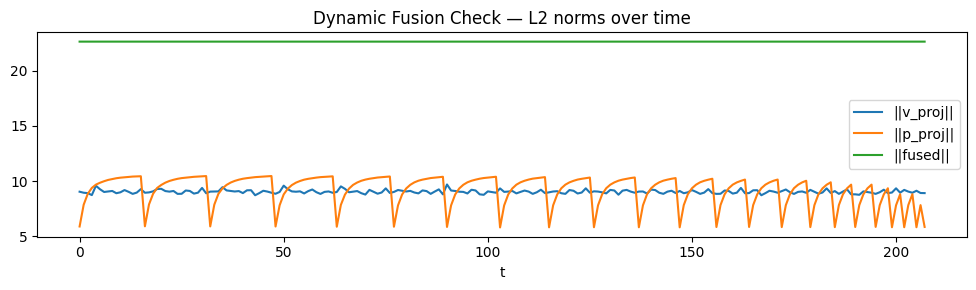

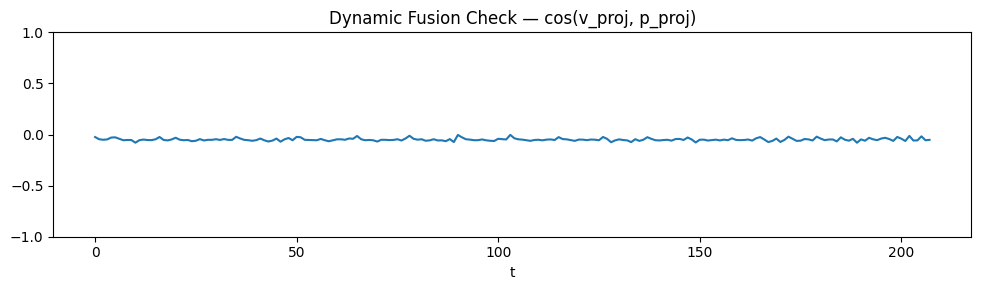

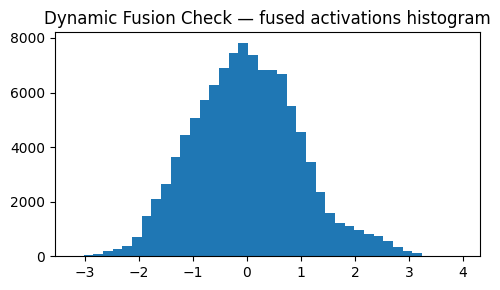

→ Fused output shape: (1, 208, 512)
Video-level representation: (1, 512)


In [45]:
# ======================================
# Full-sequence Fusion Test (Dynamic)
# ======================================
video_path, json_dir, label = data_list[0]
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"\n[Sample] Video: {video_path}\nPose folder: {json_dir}\nLabel: {label}\nDevice: {device}")

# 1) Initialize encoders
vit_encoder  = ViTEncoder().to(device).eval()
pose_encoder = PoseEncoderGRU(input_size=50, hidden_size=128).to(device).eval()

# 2) Get total frame count for dynamic loop
cap = cv2.VideoCapture(video_path)
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
cap.release()
print(f"Total frames in video: {total_frames}")

batch_size = 16  # process in 16-frame chunks
visual_list = []
pose_list   = []

# 3) Loop through all frames and JSONs in sync
for start in range(0, total_frames, batch_size):
    end = min(start + batch_size, total_frames)

    # --- A) Frames → ViT tokens (T,768)
    frames = extract_video_frames(video_path, start=start, num_frames=end - start)
    if frames is None or len(frames) == 0:
        continue
    frames = frames.to(device)
    B, T, C, H, W = 1, frames.shape[0], frames.shape[1], frames.shape[2], frames.shape[3]
    with torch.no_grad():
        v_feats = vit_encoder(frames.view(B*T, C, H, W)).view(B, T, -1).squeeze(0)  # (T,768)
    visual_list.append(v_feats.cpu())

    # --- B) JSON → Pose → GRU tokens (T,128)
    pose_seq = extract_pose_sequence(json_dir, start=start, num_frames=end - start, debug=False)
    if pose_seq is None or pose_seq.shape[0] == 0:
        continue
    pose_flat = (pose_seq / 224.0).reshape(pose_seq.shape[0], -1).unsqueeze(0).to(device)  # (1,T,50)
    with torch.no_grad():
        p_feats = pose_encoder(pose_flat).squeeze(0)  # (T,128)
    pose_list.append(p_feats.cpu())

# 4) Combine all chunks
if len(visual_list) == 0 or len(pose_list) == 0:
    print("⚠️ No valid visual/pose data extracted — check paths.")
else:
    visual_tokens = torch.cat(visual_list, dim=0).to(device)  # (total_T,768)
    pose_tokens   = torch.cat(pose_list, dim=0).to(device)    # (total_T,128)
    print(f"✅ Combined shapes — visual: {tuple(visual_tokens.shape)}, pose: {tuple(pose_tokens.shape)}")

    # --- C) Fusion + diagnostics
    fusion_layer = TokenFusionLayerStrict(
        visual_dim=768, pose_dim=128, fusion_dim=512, dropout=0.1, debug=True
    ).to(device).eval()

    with torch.no_grad():
        fused = fuse_and_inspect(fusion_layer, visual_tokens, pose_tokens, title="Dynamic Fusion Check")  # (1,T,512)

    print("→ Fused output shape:", tuple(fused.shape))  # (1,T,512)

    # Optional: pooled video representation
    video_repr = fused.mean(dim=1)  # (1,512)
    print("Video-level representation:", tuple(video_repr.shape))


In [46]:
#dataset wrapper
from torch.utils.data import Dataset
import torch

class FusedVideoPoseDataset(Dataset):
    def __init__(self, data_list, vit_encoder, pose_encoder, fusion_layer,
                 num_frames=None, batch_size=16, device="cpu"):
        """
        data_list   : list of (video_path, json_dir, label)
        vit_encoder : instance of ViTEncoder
        pose_encoder: instance of PoseEncoderGRU
        fusion_layer: instance of TokenFusionLayerStrict
        num_frames  : number of frames/poses per sample
                      - None → use ALL frames dynamically
                      - int  → sample uniformly that many frames
        batch_size  : chunk size for memory-safe processing (e.g., 16)
        device      : 'cpu' or 'cuda'
        """
        self.data_list = data_list
        self.vit = vit_encoder.to(device).eval()
        self.pose = pose_encoder.to(device).eval()
        self.fusion = fusion_layer.to(device).eval()
        self.num_frames = num_frames
        self.batch_size = batch_size
        self.device = device

    def __len__(self):
        return len(self.data_list)

    def __getitem__(self, idx):
        video_path, json_dir, label = self.data_list[idx]

        # --- (1) Determine total frames
        cap = cv2.VideoCapture(video_path)
        total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        cap.release()
        total_to_load = total_frames if self.num_frames is None else min(self.num_frames, total_frames)

        visual_list, pose_list = [], []

        # --- (2) Process in small chunks for memory safety
        for start in range(0, total_to_load, self.batch_size):
            end = min(start + self.batch_size, total_to_load)

            # Frames → ViT
            frames = extract_video_frames(video_path, start=start, num_frames=end - start)
            if frames is None or len(frames) == 0:
                continue
            frames = frames.to(self.device)
            B, T, C, H, W = 1, frames.shape[0], frames.shape[1], frames.shape[2], frames.shape[3]
            with torch.no_grad():
                visual_feats = self.vit(frames.view(B*T, C, H, W)).view(B, T, -1).squeeze(0)
            visual_list.append(visual_feats.cpu())

            # Poses → GRU
            pose_seq = extract_pose_sequence(json_dir, start=start, num_frames=end - start, debug=False)
            if pose_seq is None or pose_seq.shape[0] == 0:
                continue
            pose_flat = (pose_seq / 224.0).reshape(pose_seq.shape[0], -1).unsqueeze(0).to(self.device)
            with torch.no_grad():
                pose_feats = self.pose(pose_flat).squeeze(0)
            pose_list.append(pose_feats.cpu())

        # --- (3) Combine all chunks
        if len(visual_list) == 0 or len(pose_list) == 0:
            raise RuntimeError(f"No valid data extracted for sample {video_path}")

        visual_tokens = torch.cat(visual_list, dim=0).to(self.device)  # (T,768)
        pose_tokens   = torch.cat(pose_list, dim=0).to(self.device)    # (T,128)

        # --- (4) Fuse
        # Ensure time alignment before fusion
        min_T = min(visual_tokens.shape[0], pose_tokens.shape[0])
        if visual_tokens.shape[0] != pose_tokens.shape[0]:
            print(f"⚠️ Time mismatch fixed for sample {idx}: "
                  f"visual={visual_tokens.shape[0]} pose={pose_tokens.shape[0]} → using {min_T}")
        visual_tokens = visual_tokens[:min_T]
        pose_tokens   = pose_tokens[:min_T]
        with torch.no_grad():
            fused = self.fusion(visual_tokens, pose_tokens)            # (1,T,512)

        return fused.squeeze(0), int(label)  # (T,512), label


In [47]:
from tqdm import tqdm
import torch

# ===================================================
# Cell 5 — Build fused token dataset (Dynamic)
# ===================================================
all_fused_tokens, all_labels = [], []
skipped = 0
batch_size = 16  # memory-safe chunk size

for video_path, json_path, label in tqdm(data_list, desc="Building fused tokens (dynamic)"):
    try:
        # --- Determine total number of frames
        cap = cv2.VideoCapture(video_path)
        total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        cap.release()
        if total_frames == 0:
            print(f" Skipping (no frames): {video_path}")
            skipped += 1
            continue

        visual_list, pose_list = [], []

        # --- Loop through all frames in chunks
        for start in range(0, total_frames, batch_size):
            end = min(start + batch_size, total_frames)

            # (A) Extract frames
            frames_tensor = extract_video_frames(video_path, start=start, num_frames=end - start)
            if frames_tensor is None or len(frames_tensor) == 0:
                continue
            frames_tensor = frames_tensor.to(device)

            # Encode with ViT
            B, T, C, H, W = 1, frames_tensor.shape[0], frames_tensor.shape[1], frames_tensor.shape[2], frames_tensor.shape[3]
            with torch.no_grad():
                visual_feats = vit_encoder(frames_tensor.view(B*T, C, H, W)).view(B, T, -1).squeeze(0)  # (T,768)
            visual_list.append(visual_feats.cpu())

            # (B) Extract pose sequence
            pose_tensor = extract_pose_sequence(json_path, start=start, num_frames=end - start, debug=False)
            if pose_tensor is None or pose_tensor.shape[0] == 0:
                continue
            pose_input = (pose_tensor / 224.0).reshape(pose_tensor.shape[0], -1).unsqueeze(0).to(device)  # (1,T,50)

            # Encode with GRU
            with torch.no_grad():
                pose_feats = pose_encoder(pose_input).squeeze(0)  # (T,128)
            pose_list.append(pose_feats.cpu())

        # --- Combine all chunks
        if len(visual_list) == 0 or len(pose_list) == 0:
            print(f" Skipped (no valid chunks): {video_path}")
            skipped += 1
            continue

        visual_tokens = torch.cat(visual_list, dim=0).to(device)  # (total_T,768)
        pose_tokens   = torch.cat(pose_list, dim=0).to(device)    # (total_T,128)

        # --- Align lengths before fusion
        min_T = min(visual_tokens.shape[0], pose_tokens.shape[0])
        if visual_tokens.shape[0] != pose_tokens.shape[0]:
            print(f"Time mismatch fixed: visual={visual_tokens.shape[0]} pose={pose_tokens.shape[0]} → using {min_T}")
        visual_tokens = visual_tokens[:min_T]
        pose_tokens   = pose_tokens[:min_T]

        # --- Fuse
        with torch.no_grad():
            fused = fusion_layer(visual_tokens, pose_tokens)       # (1,total_T,512)

        all_fused_tokens.append(fused.squeeze(0).cpu())            # (total_T,512)
        all_labels.append(int(label))

    except Exception as e:
        print(f" Error processing {video_path}: {e}")
        skipped += 1
        continue

print(f"Built fused tokens: {len(all_fused_tokens)} items; Skipped: {skipped}.")


Building fused tokens (dynamic):   2%|▋                                        | 1/55 [00:23<21:12, 23.56s/it]

[Fusion] inputs   visual=(1, 208, 768)  pose=(1, 208, 128)
[Fusion] project  v_proj=(1, 208, 512)  p_proj=(1, 208, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.053  0.45  -0.541  0.149 -0.055]
[Fusion] samples  p_proj[0,0,:5]=[ 0.165 -0.06   0.045  0.314 -0.134]
[Fusion] output   fused=(1, 208, 512) fused[0,0,:5]=[ 0.242  0.831 -1.046  0.988 -0.397]


Building fused tokens (dynamic):   4%|█▍                                       | 2/55 [00:34<14:23, 16.29s/it]

[Fusion] inputs   visual=(1, 101, 768)  pose=(1, 101, 128)
[Fusion] project  v_proj=(1, 101, 512)  p_proj=(1, 101, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.504  0.464 -0.477  0.497  0.073]
[Fusion] samples  p_proj[0,0,:5]=[ 0.159 -0.057  0.05   0.339 -0.141]
[Fusion] output   fused=(1, 101, 512) fused[0,0,:5]=[-0.661  0.885 -0.83   1.768 -0.09 ]


Building fused tokens (dynamic):   5%|██▏                                      | 3/55 [00:59<17:28, 20.15s/it]

[Fusion] inputs   visual=(1, 560, 768)  pose=(1, 560, 128)
[Fusion] project  v_proj=(1, 560, 512)  p_proj=(1, 560, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.334 -0.003 -0.489  0.169 -0.259]
[Fusion] samples  p_proj[0,0,:5]=[ 0.173 -0.115  0.061  0.204 -0.087]
[Fusion] output   fused=(1, 560, 512) fused[0,0,:5]=[-0.448 -0.34  -1.111  0.885 -0.908]


Building fused tokens (dynamic):   7%|██▉                                      | 4/55 [01:37<23:12, 27.30s/it]

[Fusion] inputs   visual=(1, 398, 768)  pose=(1, 398, 128)
[Fusion] project  v_proj=(1, 398, 512)  p_proj=(1, 398, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.542  0.461 -0.295  0.444 -0.083]
[Fusion] samples  p_proj[0,0,:5]=[ 0.167 -0.056  0.044  0.343 -0.145]
[Fusion] output   fused=(1, 398, 512) fused[0,0,:5]=[-0.71   0.89  -0.455  1.674 -0.407]


Building fused tokens (dynamic):   9%|███▋                                     | 5/55 [01:44<16:27, 19.75s/it]

[Fusion] inputs   visual=(1, 155, 768)  pose=(1, 155, 128)
[Fusion] project  v_proj=(1, 155, 512)  p_proj=(1, 155, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.187 -0.081 -0.391  0.361 -0.406]
[Fusion] samples  p_proj[0,0,:5]=[ 0.106 -0.095  0.059  0.36   0.1  ]
[Fusion] output   fused=(1, 155, 512) fused[0,0,:5]=[ 0.668 -0.416 -0.778  1.66  -0.718]


Building fused tokens (dynamic):  11%|████▍                                    | 6/55 [02:19<20:20, 24.91s/it]

[Fusion] inputs   visual=(1, 411, 768)  pose=(1, 411, 128)
[Fusion] project  v_proj=(1, 411, 512)  p_proj=(1, 411, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.085  0.457 -0.597  0.338  0.231]
[Fusion] samples  p_proj[0,0,:5]=[ 0.171 -0.06   0.048  0.337 -0.141]
[Fusion] output   fused=(1, 411, 512) fused[0,0,:5]=[ 0.229  0.87  -1.077  1.44   0.238]


Building fused tokens (dynamic):  13%|█████▏                                   | 7/55 [02:37<18:08, 22.67s/it]

[Fusion] inputs   visual=(1, 176, 768)  pose=(1, 176, 128)
[Fusion] project  v_proj=(1, 176, 512)  p_proj=(1, 176, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.167  0.509 -0.069  0.532  0.02 ]
[Fusion] samples  p_proj[0,0,:5]=[ 0.168 -0.059  0.047  0.341 -0.148]
[Fusion] output   fused=(1, 176, 512) fused[0,0,:5]=[ 0.048  0.953  0.002  1.805 -0.212]


Building fused tokens (dynamic):  15%|█████▉                                   | 8/55 [02:52<15:49, 20.20s/it]

[Fusion] inputs   visual=(1, 156, 768)  pose=(1, 156, 128)
[Fusion] project  v_proj=(1, 156, 512)  p_proj=(1, 156, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.379  0.511 -0.356  0.435 -0.144]
[Fusion] samples  p_proj[0,0,:5]=[ 0.16  -0.064  0.053  0.351 -0.15 ]
[Fusion] output   fused=(1, 156, 512) fused[0,0,:5]=[-0.413  0.941 -0.584  1.631 -0.565]


Building fused tokens (dynamic):  16%|██████▋                                  | 9/55 [02:57<12:03, 15.73s/it]

[Fusion] inputs   visual=(1, 77, 768)  pose=(1, 77, 128)
[Fusion] project  v_proj=(1, 77, 512)  p_proj=(1, 77, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.011  0.07  -0.401 -0.139  0.402]
[Fusion] samples  p_proj[0,0,:5]=[ 0.128 -0.091  0.027  0.381 -0.109]
[Fusion] output   fused=(1, 77, 512) fused[0,0,:5]=[ 0.287 -0.069 -0.855  0.517  0.631]


Building fused tokens (dynamic):  18%|███████▎                                | 10/55 [03:08<10:33, 14.08s/it]

[Fusion] inputs   visual=(1, 90, 768)  pose=(1, 90, 128)
[Fusion] project  v_proj=(1, 90, 512)  p_proj=(1, 90, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.434  0.398 -0.506  0.577  0.111]
[Fusion] samples  p_proj[0,0,:5]=[ 0.153 -0.05   0.052  0.329 -0.135]
[Fusion] output   fused=(1, 90, 512) fused[0,0,:5]=[-0.52   0.769 -0.874  1.91   0.007]


Building fused tokens (dynamic):  20%|████████                                | 11/55 [03:32<12:30, 17.06s/it]

[Fusion] inputs   visual=(1, 228, 768)  pose=(1, 228, 128)
[Fusion] project  v_proj=(1, 228, 512)  p_proj=(1, 228, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.258  0.347  0.084  0.432  0.597]
[Fusion] samples  p_proj[0,0,:5]=[ 0.174 -0.158  0.041  0.409 -0.12 ]
[Fusion] output   fused=(1, 228, 512) fused[0,0,:5]=[-0.211  0.387  0.247  1.815  1.018]


Building fused tokens (dynamic):  22%|████████▋                               | 12/55 [03:50<12:30, 17.46s/it]

[Fusion] inputs   visual=(1, 181, 768)  pose=(1, 181, 128)
[Fusion] project  v_proj=(1, 181, 512)  p_proj=(1, 181, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.196  0.607 -0.3    0.253 -0.125]
[Fusion] samples  p_proj[0,0,:5]=[ 0.161 -0.044  0.049  0.342 -0.137]
[Fusion] output   fused=(1, 181, 512) fused[0,0,:5]=[-0.041  1.211 -0.494  1.279 -0.517]


Building fused tokens (dynamic):  24%|█████████▍                              | 13/55 [04:10<12:45, 18.23s/it]

[Fusion] inputs   visual=(1, 192, 768)  pose=(1, 192, 128)
[Fusion] project  v_proj=(1, 192, 512)  p_proj=(1, 192, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.191  0.494 -0.525  0.426 -0.113]
[Fusion] samples  p_proj[0,0,:5]=[ 0.103  0.042  0.039  0.244 -0.126]
[Fusion] output   fused=(1, 192, 512) fused[0,0,:5]=[-0.129  1.168 -0.955  1.447 -0.442]


Building fused tokens (dynamic):  25%|██████████▏                             | 14/55 [04:14<09:27, 13.85s/it]

[Fusion] inputs   visual=(1, 60, 768)  pose=(1, 60, 128)
[Fusion] project  v_proj=(1, 60, 512)  p_proj=(1, 60, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.31   0.468  0.08   0.679  0.465]
[Fusion] samples  p_proj[0,0,:5]=[ 0.067 -0.058  0.008  0.337 -0.133]
[Fusion] output   fused=(1, 60, 512) fused[0,0,:5]=[-0.588  0.953  0.194  2.384  0.77 ]


Building fused tokens (dynamic):  27%|██████████▉                             | 15/55 [04:20<07:47, 11.70s/it]

[Fusion] inputs   visual=(1, 155, 768)  pose=(1, 155, 128)
[Fusion] project  v_proj=(1, 155, 512)  p_proj=(1, 155, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.226  0.028 -0.35   0.244 -0.222]
[Fusion] samples  p_proj[0,0,:5]=[ 0.125 -0.079  0.082  0.387 -0.053]
[Fusion] output   fused=(1, 155, 512) fused[0,0,:5]=[-0.285 -0.166 -0.682  1.459 -0.699]


Building fused tokens (dynamic):  29%|███████████▋                            | 16/55 [04:40<09:13, 14.19s/it]

[Fusion] inputs   visual=(1, 170, 768)  pose=(1, 170, 128)
[Fusion] project  v_proj=(1, 170, 512)  p_proj=(1, 170, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.315  0.426 -0.753  0.252 -0.129]
[Fusion] samples  p_proj[0,0,:5]=[ 0.191 -0.094  0.045  0.418 -0.153]
[Fusion] output   fused=(1, 170, 512) fused[0,0,:5]=[-0.232  0.725 -1.456  1.435 -0.563]


Building fused tokens (dynamic):  31%|████████████▎                           | 17/55 [04:54<08:52, 14.00s/it]

[Fusion] inputs   visual=(1, 144, 768)  pose=(1, 144, 128)
[Fusion] project  v_proj=(1, 144, 512)  p_proj=(1, 144, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.251  0.434 -0.278  0.567 -0.152]
[Fusion] samples  p_proj[0,0,:5]=[ 0.157 -0.063  0.049  0.306 -0.139]
[Fusion] output   fused=(1, 144, 512) fused[0,0,:5]=[-0.174  0.806 -0.458  1.861 -0.587]


Building fused tokens (dynamic):  33%|█████████████                           | 18/55 [05:19<10:40, 17.32s/it]

Time mismatch fixed: visual=580 pose=579 → using 579
[Fusion] inputs   visual=(1, 579, 768)  pose=(1, 579, 128)
[Fusion] project  v_proj=(1, 579, 512)  p_proj=(1, 579, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.368  0.514 -0.595  0.47  -0.403]
[Fusion] samples  p_proj[0,0,:5]=[ 0.172 -0.112  0.062  0.209 -0.085]
[Fusion] output   fused=(1, 579, 512) fused[0,0,:5]=[-0.516  0.995 -1.367  1.692 -1.255]


Building fused tokens (dynamic):  35%|█████████████▊                          | 19/55 [05:36<10:19, 17.21s/it]

[Fusion] inputs   visual=(1, 434, 768)  pose=(1, 434, 128)
[Fusion] project  v_proj=(1, 434, 512)  p_proj=(1, 434, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.371  0.496 -0.812  0.415 -0.295]
[Fusion] samples  p_proj[0,0,:5]=[ 0.17  -0.114  0.061  0.203 -0.087]
[Fusion] output   fused=(1, 434, 512) fused[0,0,:5]=[-0.613  1.095 -2.224  1.784 -1.145]


Building fused tokens (dynamic):  36%|██████████████▌                         | 20/55 [05:46<08:48, 15.09s/it]

[Fusion] inputs   visual=(1, 103, 768)  pose=(1, 103, 128)
[Fusion] project  v_proj=(1, 103, 512)  p_proj=(1, 103, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.058  0.641 -0.383  0.498 -0.195]
[Fusion] samples  p_proj[0,0,:5]=[ 0.159 -0.076  0.044  0.353 -0.157]
[Fusion] output   fused=(1, 103, 512) fused[0,0,:5]=[ 0.235  1.206 -0.684  1.803 -0.711]


Building fused tokens (dynamic):  38%|███████████████▎                        | 21/55 [05:58<07:56, 14.02s/it]

[Fusion] inputs   visual=(1, 118, 768)  pose=(1, 118, 128)
[Fusion] project  v_proj=(1, 118, 512)  p_proj=(1, 118, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.164  0.33  -0.338  0.428  0.097]
[Fusion] samples  p_proj[0,0,:5]=[ 0.146 -0.038  0.065  0.335 -0.149]
[Fusion] output   fused=(1, 118, 512) fused[0,0,:5]=[ 0.013  0.647 -0.508  1.608 -0.058]


Building fused tokens (dynamic):  40%|████████████████                        | 22/55 [06:15<08:18, 15.10s/it]

[Fusion] inputs   visual=(1, 402, 768)  pose=(1, 402, 128)
[Fusion] project  v_proj=(1, 402, 512)  p_proj=(1, 402, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.326  0.463 -0.698  0.294 -0.315]
[Fusion] samples  p_proj[0,0,:5]=[ 0.17  -0.111  0.058  0.203 -0.09 ]
[Fusion] output   fused=(1, 402, 512) fused[0,0,:5]=[-0.448  0.962 -1.792  1.364 -1.14 ]


Building fused tokens (dynamic):  42%|████████████████▋                       | 23/55 [06:31<08:11, 15.37s/it]

[Fusion] inputs   visual=(1, 165, 768)  pose=(1, 165, 128)
[Fusion] project  v_proj=(1, 165, 512)  p_proj=(1, 165, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.306  0.491 -0.202  0.507  0.088]
[Fusion] samples  p_proj[0,0,:5]=[ 0.168 -0.058  0.046  0.336 -0.149]
[Fusion] output   fused=(1, 165, 512) fused[0,0,:5]=[-0.244  0.917 -0.281  1.752 -0.086]


Building fused tokens (dynamic):  44%|█████████████████▍                      | 24/55 [06:52<08:49, 17.09s/it]

[Fusion] inputs   visual=(1, 510, 768)  pose=(1, 510, 128)
[Fusion] project  v_proj=(1, 510, 512)  p_proj=(1, 510, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.318 -0.059 -0.37   0.269 -0.175]
[Fusion] samples  p_proj[0,0,:5]=[ 0.17  -0.112  0.058  0.204 -0.09 ]
[Fusion] output   fused=(1, 510, 512) fused[0,0,:5]=[-0.392 -0.446 -0.783  1.092 -0.67 ]


Building fused tokens (dynamic):  45%|██████████████████▏                     | 25/55 [07:04<07:43, 15.46s/it]

[Fusion] inputs   visual=(1, 128, 768)  pose=(1, 128, 128)
[Fusion] project  v_proj=(1, 128, 512)  p_proj=(1, 128, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.165  0.31  -0.253  0.407 -0.187]
[Fusion] samples  p_proj[0,0,:5]=[ 0.162 -0.061  0.047  0.309 -0.145]
[Fusion] output   fused=(1, 128, 512) fused[0,0,:5]=[ 0.03   0.554 -0.389  1.521 -0.65 ]


Building fused tokens (dynamic):  47%|██████████████████▉                     | 26/55 [07:12<06:22, 13.18s/it]

[Fusion] inputs   visual=(1, 138, 768)  pose=(1, 138, 128)
[Fusion] project  v_proj=(1, 138, 512)  p_proj=(1, 138, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.146  0.491 -0.77   0.147  0.441]
[Fusion] samples  p_proj[0,0,:5]=[ 0.127 -0.054  0.067  0.212  0.06 ]
[Fusion] output   fused=(1, 138, 512) fused[0,0,:5]=[-0.082  0.999 -1.697  0.816  1.149]


Building fused tokens (dynamic):  49%|███████████████████▋                    | 27/55 [07:49<09:33, 20.48s/it]

[Fusion] inputs   visual=(1, 410, 768)  pose=(1, 410, 128)
[Fusion] project  v_proj=(1, 410, 512)  p_proj=(1, 410, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.575  0.466 -0.306  0.423  0.043]
[Fusion] samples  p_proj[0,0,:5]=[ 0.168 -0.057  0.045  0.342 -0.147]
[Fusion] output   fused=(1, 410, 512) fused[0,0,:5]=[-0.768  0.909 -0.469  1.643 -0.146]


Building fused tokens (dynamic):  51%|████████████████████▎                   | 28/55 [08:12<09:33, 21.23s/it]

[Fusion] inputs   visual=(1, 842, 768)  pose=(1, 842, 128)
[Fusion] project  v_proj=(1, 842, 512)  p_proj=(1, 842, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.233  0.537  0.124 -0.238  0.518]
[Fusion] samples  p_proj[0,0,:5]=[-0.009  0.01   0.02   0.183 -0.007]
[Fusion] output   fused=(1, 842, 512) fused[0,0,:5]=[-0.614  1.376  0.36  -0.142  1.285]


Building fused tokens (dynamic):  53%|█████████████████████                   | 29/55 [08:23<07:49, 18.07s/it]

[Fusion] inputs   visual=(1, 242, 768)  pose=(1, 242, 128)
[Fusion] project  v_proj=(1, 242, 512)  p_proj=(1, 242, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.206 -0.01  -0.272 -0.162 -0.221]
[Fusion] samples  p_proj[0,0,:5]=[ 0.016  0.025 -0.101  0.409  0.056]
[Fusion] output   fused=(1, 242, 512) fused[0,0,:5]=[-0.389  0.082 -0.807  0.612 -0.332]


Building fused tokens (dynamic):  55%|█████████████████████▊                  | 30/55 [08:31<06:14, 14.98s/it]

[Fusion] inputs   visual=(1, 64, 768)  pose=(1, 64, 128)
[Fusion] project  v_proj=(1, 64, 512)  p_proj=(1, 64, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.264 -0.233 -0.319  0.404 -0.202]
[Fusion] samples  p_proj[0,0,:5]=[ 0.015  0.173  0.239  0.771 -0.11 ]
[Fusion] output   fused=(1, 64, 512) fused[0,0,:5]=[-0.562 -0.157 -0.2    2.482 -0.697]


Building fused tokens (dynamic):  56%|██████████████████████▌                 | 31/55 [08:48<06:17, 15.72s/it]

[Fusion] inputs   visual=(1, 260, 768)  pose=(1, 260, 128)
[Fusion] project  v_proj=(1, 260, 512)  p_proj=(1, 260, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.103  0.031 -0.35  -0.199  0.137]
[Fusion] samples  p_proj[0,0,:5]=[ 0.117 -0.15   0.004  0.484 -0.138]
[Fusion] output   fused=(1, 260, 512) fused[0,0,:5]=[ 0.009 -0.281 -0.772  0.595 -0.026]


Building fused tokens (dynamic):  58%|███████████████████████▎                | 32/55 [09:05<06:09, 16.06s/it]

[Fusion] inputs   visual=(1, 202, 768)  pose=(1, 202, 128)
[Fusion] project  v_proj=(1, 202, 512)  p_proj=(1, 202, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.295  0.269 -0.066  0.653 -0.065]
[Fusion] samples  p_proj[0,0,:5]=[-0.048 -0.168  0.198  0.301 -0.132]
[Fusion] output   fused=(1, 202, 512) fused[0,0,:5]=[-0.771  0.18   0.245  2.006 -0.457]


Building fused tokens (dynamic):  60%|████████████████████████                | 33/55 [09:41<08:05, 22.09s/it]

[Fusion] inputs   visual=(1, 379, 768)  pose=(1, 379, 128)
[Fusion] project  v_proj=(1, 379, 512)  p_proj=(1, 379, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.007  0.67  -0.148  0.065 -0.238]
[Fusion] samples  p_proj[0,0,:5]=[-0.12   0.174  0.081  0.527 -0.139]
[Fusion] output   fused=(1, 379, 512) fused[0,0,:5]=[-0.223  1.759 -0.127  1.235 -0.77 ]


Building fused tokens (dynamic):  62%|████████████████████████▋               | 34/55 [09:48<06:06, 17.47s/it]

[Fusion] inputs   visual=(1, 81, 768)  pose=(1, 81, 128)
[Fusion] project  v_proj=(1, 81, 512)  p_proj=(1, 81, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.424  0.116 -0.345  0.161  0.533]
[Fusion] samples  p_proj[0,0,:5]=[-0.064  0.146  0.082  0.638 -0.02 ]
[Fusion] output   fused=(1, 81, 512) fused[0,0,:5]=[ 0.731  0.531 -0.539  1.627  1.042]


Building fused tokens (dynamic):  64%|█████████████████████████▍              | 35/55 [10:08<06:02, 18.14s/it]

[Fusion] inputs   visual=(1, 484, 768)  pose=(1, 484, 128)
[Fusion] project  v_proj=(1, 484, 512)  p_proj=(1, 484, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.56   0.581  0.06   0.396  0.033]
[Fusion] samples  p_proj[0,0,:5]=[ 0.046 -0.135 -0.007  0.423 -0.087]
[Fusion] output   fused=(1, 484, 512) fused[0,0,:5]=[-1.149  1.065  0.159  1.922 -0.088]


Building fused tokens (dynamic):  65%|██████████████████████████▏             | 36/55 [10:20<05:13, 16.48s/it]

[Fusion] inputs   visual=(1, 193, 768)  pose=(1, 193, 128)
[Fusion] project  v_proj=(1, 193, 512)  p_proj=(1, 193, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.139 -0.021 -0.078  0.317  0.644]
[Fusion] samples  p_proj[0,0,:5]=[-0.015  0.063 -0.026  0.075  0.018]
[Fusion] output   fused=(1, 193, 512) fused[0,0,:5]=[-0.294  0.178 -0.173  1.02   1.671]


Building fused tokens (dynamic):  67%|██████████████████████████▉             | 37/55 [10:29<04:14, 14.15s/it]

[Fusion] inputs   visual=(1, 88, 768)  pose=(1, 88, 128)
[Fusion] project  v_proj=(1, 88, 512)  p_proj=(1, 88, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.407 -0.142 -0.273 -0.207  0.165]
[Fusion] samples  p_proj[0,0,:5]=[-0.016  0.052  0.132  0.456 -0.112]
[Fusion] output   fused=(1, 88, 512) fused[0,0,:5]=[ 0.794 -0.167 -0.267  0.511  0.118]


Building fused tokens (dynamic):  69%|███████████████████████████▋            | 38/55 [10:55<04:58, 17.57s/it]

[Fusion] inputs   visual=(1, 354, 768)  pose=(1, 354, 128)
[Fusion] project  v_proj=(1, 354, 512)  p_proj=(1, 354, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.161  0.27  -0.494  0.407  0.046]
[Fusion] samples  p_proj[0,0,:5]=[ 0.059 -0.092  0.127  0.714 -0.303]
[Fusion] output   fused=(1, 354, 512) fused[0,0,:5]=[ 0.454  0.359 -0.848  2.445 -0.603]


Building fused tokens (dynamic):  71%|████████████████████████████▎           | 39/55 [11:07<04:17, 16.08s/it]

[Fusion] inputs   visual=(1, 130, 768)  pose=(1, 130, 128)
[Fusion] project  v_proj=(1, 130, 512)  p_proj=(1, 130, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.18  -0.538 -0.962 -0.061  0.196]
[Fusion] samples  p_proj[0,0,:5]=[ 0.097  0.037  0.03   0.323 -0.116]
[Fusion] output   fused=(1, 130, 512) fused[0,0,:5]=[-0.087 -0.98  -1.901  0.649  0.263]


Building fused tokens (dynamic):  73%|█████████████████████████████           | 40/55 [11:26<04:13, 16.91s/it]

[Fusion] inputs   visual=(1, 324, 768)  pose=(1, 324, 128)
[Fusion] project  v_proj=(1, 324, 512)  p_proj=(1, 324, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.758 -0.093 -0.202 -0.078 -0.723]
[Fusion] samples  p_proj[0,0,:5]=[ 0.107 -0.071  0.059  0.191 -0.067]
[Fusion] output   fused=(1, 324, 512) fused[0,0,:5]=[-1.503 -0.374 -0.324  0.27  -1.826]


Building fused tokens (dynamic):  75%|█████████████████████████████▊          | 41/55 [11:32<03:11, 13.69s/it]

[Fusion] inputs   visual=(1, 106, 768)  pose=(1, 106, 128)
[Fusion] project  v_proj=(1, 106, 512)  p_proj=(1, 106, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.897 -0.41  -0.463 -0.219  0.248]
[Fusion] samples  p_proj[0,0,:5]=[ 0.117  0.015  0.043  0.325 -0.09 ]
[Fusion] output   fused=(1, 106, 512) fused[0,0,:5]=[-1.702 -0.837 -0.894  0.286  0.4  ]


Building fused tokens (dynamic):  76%|██████████████████████████████▌         | 42/55 [11:41<02:37, 12.15s/it]

[Fusion] inputs   visual=(1, 122, 768)  pose=(1, 122, 128)
[Fusion] project  v_proj=(1, 122, 512)  p_proj=(1, 122, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.371  0.689 -0.279 -0.332  0.069]
[Fusion] samples  p_proj[0,0,:5]=[ 0.143 -0.273 -0.003  0.493 -0.163]
[Fusion] output   fused=(1, 122, 512) fused[0,0,:5]=[-0.523  0.867 -0.639  0.316 -0.234]


Building fused tokens (dynamic):  78%|███████████████████████████████▎        | 43/55 [11:46<02:01, 10.13s/it]

[Fusion] inputs   visual=(1, 211, 768)  pose=(1, 211, 128)
[Fusion] project  v_proj=(1, 211, 512)  p_proj=(1, 211, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.516 -0.011 -0.122 -0.53   0.037]
[Fusion] samples  p_proj[0,0,:5]=[0.026 0.016 0.027 0.2   0.031]
[Fusion] output   fused=(1, 211, 512) fused[0,0,:5]=[-1.228  0.021 -0.233 -0.825  0.179]


Building fused tokens (dynamic):  80%|████████████████████████████████        | 44/55 [11:59<02:00, 10.92s/it]

[Fusion] inputs   visual=(1, 134, 768)  pose=(1, 134, 128)
[Fusion] project  v_proj=(1, 134, 512)  p_proj=(1, 134, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 3.656e-01 -3.433e-01 -8.790e-01  8.127e-04 -4.619e-01]
[Fusion] samples  p_proj[0,0,:5]=[ 0.096  0.037  0.02   0.331 -0.109]
[Fusion] output   fused=(1, 134, 512) fused[0,0,:5]=[ 1.069 -0.53  -1.678  0.799 -1.079]


Building fused tokens (dynamic):  82%|████████████████████████████████▋       | 45/55 [12:17<02:09, 12.95s/it]

[Fusion] inputs   visual=(1, 316, 768)  pose=(1, 316, 128)
[Fusion] project  v_proj=(1, 316, 512)  p_proj=(1, 316, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.202 -0.056 -0.147  0.07   0.459]
[Fusion] samples  p_proj[0,0,:5]=[ 0.135  0.006  0.017  0.316 -0.088]
[Fusion] output   fused=(1, 316, 512) fused[0,0,:5]=[-0.053 -0.018 -0.186  0.906  0.874]


Building fused tokens (dynamic):  84%|█████████████████████████████████▍      | 46/55 [12:34<02:09, 14.38s/it]

[Fusion] inputs   visual=(1, 179, 768)  pose=(1, 179, 128)
[Fusion] project  v_proj=(1, 179, 512)  p_proj=(1, 179, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.032 -0.109  0.771 -0.154  0.539]
[Fusion] samples  p_proj[0,0,:5]=[ 0.112 -0.075  0.181  0.625 -0.111]
[Fusion] output   fused=(1, 179, 512) fused[0,0,:5]=[ 0.164 -0.409  2.061  1.016  0.922]


Building fused tokens (dynamic):  85%|██████████████████████████████████▏     | 47/55 [12:45<01:44, 13.12s/it]

[Fusion] inputs   visual=(1, 87, 768)  pose=(1, 87, 128)
[Fusion] project  v_proj=(1, 87, 512)  p_proj=(1, 87, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.186 -0.021  0.168 -0.305  0.258]
[Fusion] samples  p_proj[0,0,:5]=[ 0.092 -0.134  0.201  0.414 -0.032]
[Fusion] output   fused=(1, 87, 512) fused[0,0,:5]=[ 0.658 -0.297  0.858  0.285  0.542]


Building fused tokens (dynamic):  87%|██████████████████████████████████▉     | 48/55 [13:21<02:21, 20.24s/it]

Time mismatch fixed: visual=544 pose=543 → using 543
[Fusion] inputs   visual=(1, 543, 768)  pose=(1, 543, 128)
[Fusion] project  v_proj=(1, 543, 512)  p_proj=(1, 543, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.104 -0.102 -0.626  0.299 -0.547]
[Fusion] samples  p_proj[0,0,:5]=[ 0.093 -0.152 -0.012  0.486 -0.125]
[Fusion] output   fused=(1, 543, 512) fused[0,0,:5]=[-0.05  -0.593 -1.449  1.722 -1.523]


Building fused tokens (dynamic):  89%|███████████████████████████████████▋    | 49/55 [13:46<02:08, 21.47s/it]

[Fusion] inputs   visual=(1, 147, 768)  pose=(1, 147, 128)
[Fusion] project  v_proj=(1, 147, 512)  p_proj=(1, 147, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.475 -0.31  -0.417  0.411 -0.528]
[Fusion] samples  p_proj[0,0,:5]=[ 0.017 -0.126 -0.046  0.428 -0.058]
[Fusion] output   fused=(1, 147, 512) fused[0,0,:5]=[-0.961 -0.914 -0.971  1.772 -1.231]


Building fused tokens (dynamic):  91%|████████████████████████████████████▎   | 50/55 [14:04<01:42, 20.53s/it]

[Fusion] inputs   visual=(1, 246, 768)  pose=(1, 246, 128)
[Fusion] project  v_proj=(1, 246, 512)  p_proj=(1, 246, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.219  0.137 -0.043 -0.023  0.271]
[Fusion] samples  p_proj[0,0,:5]=[ 0.19   0.091  0.326  0.593 -0.206]
[Fusion] output   fused=(1, 246, 512) fused[0,0,:5]=[0.902 0.485 0.611 1.273 0.11 ]


Building fused tokens (dynamic):  93%|█████████████████████████████████████   | 51/55 [14:26<01:23, 20.83s/it]

[Fusion] inputs   visual=(1, 842, 768)  pose=(1, 842, 128)
[Fusion] project  v_proj=(1, 842, 512)  p_proj=(1, 842, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.233  0.537  0.124 -0.238  0.518]
[Fusion] samples  p_proj[0,0,:5]=[-0.009  0.01   0.02   0.183 -0.007]
[Fusion] output   fused=(1, 842, 512) fused[0,0,:5]=[-0.614  1.376  0.36  -0.142  1.285]


Building fused tokens (dynamic):  95%|█████████████████████████████████████▊  | 52/55 [14:59<01:13, 24.52s/it]

[Fusion] inputs   visual=(1, 488, 768)  pose=(1, 488, 128)
[Fusion] project  v_proj=(1, 488, 512)  p_proj=(1, 488, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.064  0.265 -0.346  0.309 -0.398]
[Fusion] samples  p_proj[0,0,:5]=[ 0.028 -0.172 -0.063  0.496 -0.133]
[Fusion] output   fused=(1, 488, 512) fused[0,0,:5]=[ 0.197  0.201 -0.836  1.67  -1.088]


Building fused tokens (dynamic):  96%|██████████████████████████████████████▌ | 53/55 [15:03<00:36, 18.40s/it]

[Fusion] inputs   visual=(1, 196, 768)  pose=(1, 196, 128)
[Fusion] project  v_proj=(1, 196, 512)  p_proj=(1, 196, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.024  0.257 -0.672  0.445 -0.742]
[Fusion] samples  p_proj[0,0,:5]=[ 0.021  0.043  0.001  0.192 -0.014]
[Fusion] output   fused=(1, 196, 512) fused[0,0,:5]=[ 0.119  0.702 -1.511  1.467 -1.704]


Building fused tokens (dynamic):  98%|███████████████████████████████████████▎| 54/55 [15:23<00:19, 19.03s/it]

[Fusion] inputs   visual=(1, 262, 768)  pose=(1, 262, 128)
[Fusion] project  v_proj=(1, 262, 512)  p_proj=(1, 262, 512)
[Fusion] samples  v_proj[0,0,:5]=[ 0.158 -0.149 -0.53   0.27   0.246]
[Fusion] samples  p_proj[0,0,:5]=[ 0.075 -0.037  0.003  0.345 -0.09 ]
[Fusion] output   fused=(1, 262, 512) fused[0,0,:5]=[ 0.543 -0.431 -1.224  1.43   0.362]


Building fused tokens (dynamic): 100%|████████████████████████████████████████| 55/55 [15:31<00:00, 16.93s/it]

[Fusion] inputs   visual=(1, 72, 768)  pose=(1, 72, 128)
[Fusion] project  v_proj=(1, 72, 512)  p_proj=(1, 72, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.279 -0.246  0.287 -0.001 -0.119]
[Fusion] samples  p_proj[0,0,:5]=[-0.12   0.147  0.109  0.442 -0.072]
[Fusion] output   fused=(1, 72, 512) fused[0,0,:5]=[-0.846 -0.184  0.91   1.01  -0.387]
Built fused tokens: 55 items; Skipped: 0.


In [48]:
# =========================================
# Cell 6 — Train/Val/Test split (stratified)
# =========================================
from sklearn.model_selection import train_test_split

labels_np = np.array(all_labels)
idx = np.arange(len(labels_np))

# 60/20/20 split
train_idx, temp_idx = train_test_split(
    idx, test_size=0.4, random_state=42, stratify=labels_np
)
val_idx, test_idx = train_test_split(
    temp_idx, test_size=0.5, random_state=42, stratify=labels_np[temp_idx]
)

print(f"Train: {len(train_idx)}, Val: {len(val_idx)}, Test: {len(test_idx)}")

def samples_from_indices(indices):
    samples = []
    for i in indices:
        ft = all_fused_tokens[i]
        label_id = all_labels[i]
        samples.append((ft, label_id))
    return samples

train_pairs = samples_from_indices(train_idx)
val_pairs   = samples_from_indices(val_idx)
test_pairs  = samples_from_indices(test_idx)
print(f" Samples built: Train={len(train_pairs)}, Val={len(val_pairs)}, Test={len(test_pairs)}")

Train: 33, Val: 11, Test: 11
 Samples built: Train=33, Val=11, Test=11


In [49]:
# ============================================
# Cell 7 — Prompt builder (aligned with Subsets)
# ============================================
def fused_tensor_to_prompt(fused_tensor):
    # fused_tensor: (T,512)
    token_strs = []
    for token in fused_tensor:
        token_vals = ", ".join([f"{v.item():.3f}" for v in token])
        token_strs.append(f"[{token_vals}]")
    prompt = "Classify this patient based on fused features: " + " | ".join(token_strs)
    return prompt

def make_samples_from_subset(subset):
    items = []
    for i in range(len(subset)):
        ft, label_id = subset[i]                       # ft: (T,512) tensor, label_id: int
        prompt = fused_tensor_to_prompt(ft)

        # ✅ Replace these short responses with descriptive sentences
        if int(label_id) == 0:
            response = (
                "The patient appears healthy, showing stable and coordinated movement "
                "with consistent posture and no signs of tremor or stiffness."
            )
        else:
            response = (
                "The patient likely shows Parkinson’s disease symptoms, including irregular "
                "movement patterns, reduced coordination, and possible tremor indications."
            )

        items.append({
            "prompt": prompt,
            "response": response,
            "label_id": int(label_id)
        })
    return items

# Build HF-style samples from your splits
train_samples = make_samples_from_subset(train_pairs)
val_samples   = make_samples_from_subset(val_pairs)
test_samples  = make_samples_from_subset(test_pairs)

# Print to verify (prompt + label/response)
if len(train_samples) > 0:
    print("[Sample prompt preview]")
    print(train_samples[0]["prompt"][:200], "...")
    print("label_id:", train_samples[0]["label_id"], "| response:", train_samples[0]["response"])


[Sample prompt preview]
Classify this patient based on fused features: [0.009, -0.281, -0.772, 0.595, -0.026, -0.401, 0.037, 0.320, 1.485, 1.229, 0.216, -1.322, -0.032, -1.082, 0.431, -0.670, -0.945, -0.104, -2.186, 0.344, 0 ...
label_id: 1 | response: The patient likely shows Parkinson’s disease symptoms, including irregular movement patterns, reduced coordination, and possible tremor indications.


In [50]:
# =======================================================
# Cell 8 — Load TinyLLaMA 4-bit + LoRA & build HF splits
# =======================================================
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer, BitsAndBytesConfig
from peft import LoraConfig, get_peft_model, prepare_model_for_kbit_training
from datasets import Dataset

model_name = "TinyLlama/TinyLlama-1.1B-Chat-v1.0"

# 4-bit config (fallback if not available)
try:
    bnb_config = BitsAndBytesConfig(
        load_in_4bit=True,
        bnb_4bit_use_double_quant=True,
        bnb_4bit_quant_type="nf4",
        bnb_4bit_compute_dtype=torch.float16,
    )
    _quant_kwargs = dict(quantization_config=bnb_config, device_map="auto")
except Exception:
    _quant_kwargs = dict(device_map="auto")

model = AutoModelForCausalLM.from_pretrained(
    model_name,
    torch_dtype=torch.float16,
    **_quant_kwargs
)

tokenizer = AutoTokenizer.from_pretrained(model_name)
tokenizer.pad_token = tokenizer.eos_token
tokenizer.padding_side = "right"  # keep it simple for causal LM here

lora_config = LoraConfig(
    r=8, lora_alpha=16, target_modules=["q_proj", "v_proj"],
    lora_dropout=0.1, bias="none", task_type="CAUSAL_LM",
)

model = prepare_model_for_kbit_training(model)
model = get_peft_model(model, lora_config)
model.print_trainable_parameters()

# ---- Build HF datasets from your previously created samples ----
# (uses train_samples / val_samples / test_samples from Cell 7)
train_ds = Dataset.from_list(train_samples)
val_ds   = Dataset.from_list(val_samples)
test_ds  = Dataset.from_list(test_samples)

# Quick sanity prints so you can see prompt + label
print("\n[HF Datasets]")
print("train:", len(train_ds), "| val:", len(val_ds), "| test:", len(test_ds))

if len(train_ds) > 0:
    ex = train_ds[0]
    print("\n[Sample item]")
    print("prompt:", ex["prompt"][:200], "...")
    print("response:", ex["response"], "| label_id:", ex["label_id"])

    # also show tokenized length for this prompt
    toks = tokenizer(ex["prompt"], truncation=False, add_special_tokens=True)
    print("token_count(prompt):", len(toks["input_ids"]))


/home/grad1/yes/envs/ai_env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
`torch_dtype` is deprecated! Use `dtype` instead!


trainable params: 1,126,400 || all params: 1,101,174,784 || trainable%: 0.1023

[HF Datasets]
train: 33 | val: 11 | test: 11

[Sample item]
prompt: Classify this patient based on fused features: [0.009, -0.281, -0.772, 0.595, -0.026, -0.401, 0.037, 0.320, 1.485, 1.229, 0.216, -1.322, -0.032, -1.082, 0.431, -0.670, -0.945, -0.104, -2.186, 0.344, 0 ...
response: The patient likely shows Parkinson’s disease symptoms, including irregular movement patterns, reduced coordination, and possible tremor indications. | label_id: 1


Token indices sequence length is longer than the specified maximum sequence length for this model (932110 > 2048). Running this sequence through the model will result in indexing errors


token_count(prompt): 932110


In [51]:
# Build HF datasets
train_ds = Dataset.from_list(train_samples)
val_ds   = Dataset.from_list(val_samples)
test_ds  = Dataset.from_list(test_samples)

def tokenize_example(example, resp_max_len=8):
    x = tokenizer(example["prompt"], truncation=True, padding="max_length", max_length=512)
    y = tokenizer(example["response"], truncation=True, padding="max_length", max_length=resp_max_len)
    x["labels"] = y["input_ids"]
    return x

tokenized_train = train_ds.map(tokenize_example, batched=False)
tokenized_val   = val_ds.map(tokenize_example,   batched=False)
tokenized_test  = test_ds.map(tokenize_example,  batched=False)

len(tokenized_train), len(tokenized_val), len(tokenized_test)

Map: 100%|█████████████████████████████████████████████████████████████| 11/11 [00:05<00:00,  2.04 examples/s]


(33, 11, 11)

In [52]:
print("\n[Sanity check after tokenization]")
ex = tokenized_train[0]
print("Prompt (raw):", train_ds[0]["prompt"][:200], "...")
print("Response (raw):", train_ds[0]["response"])
print("input_ids[:20]:", ex["input_ids"][:20])
print("labels:", ex["labels"])
print("Decoded labels:", tokenizer.decode([id for id in ex["labels"] if id != tokenizer.pad_token_id]))


[Sanity check after tokenization]
Prompt (raw): Classify this patient based on fused features: [0.009, -0.281, -0.772, 0.595, -0.026, -0.401, 0.037, 0.320, 1.485, 1.229, 0.216, -1.322, -0.032, -1.082, 0.431, -0.670, -0.945, -0.104, -2.186, 0.344, 0 ...
Response (raw): The patient likely shows Parkinson’s disease symptoms, including irregular movement patterns, reduced coordination, and possible tremor indications.
input_ids[:20]: [1, 4134, 1598, 445, 16500, 2729, 373, 285, 3880, 5680, 29901, 518, 29900, 29889, 29900, 29900, 29929, 29892, 448, 29900]
labels: [1, 450, 16500, 5517, 3697, 4815, 26803, 30010]
Decoded labels: <s> The patient likely shows Parkinson’


In [53]:
# ---- Drop-in collator that guarantees response tokens are kept ----
class PromptResponseCollator:
    def __init__(self, tokenizer, max_len=512, keep_eos_sep=True):
        self.tokenizer = tokenizer
        self.max_len = max_len
        self.keep_eos_sep = keep_eos_sep
        self.eos_id = tokenizer.eos_token_id

    def __call__(self, features):
        prompts   = [f["prompt"]   for f in features]
        responses = [f["response"] for f in features]

        input_id_list      = []
        attention_mask_list= []
        labels_list        = []

        for p, r in zip(prompts, responses):
            # 1) tokenize response (no special tokens; we'll manage EOS)
            resp_enc = self.tokenizer(
                r, add_special_tokens=False, padding=False, truncation=False
            )
            resp_ids = resp_enc["input_ids"]
            # Always add a final EOS to the response to mark end
            resp_ids = resp_ids + [self.eos_id]
            resp_len = len(resp_ids)

            # 2) compute max prompt length so response fits
            #    +1 for a separator EOS between prompt and response (optional)
            sep_cost = 1 if self.keep_eos_sep else 0
            max_prompt_len = max(1, self.max_len - resp_len - sep_cost)

            # 3) tokenize prompt, truncate from the LEFT to keep recent tokens
            prompt_enc = self.tokenizer(
                p, add_special_tokens=True, padding=False, truncation=True,
                max_length=max_prompt_len
            )
            prompt_ids = prompt_enc["input_ids"]
            # If we want a visible separator between prompt and response, add EOS
            if self.keep_eos_sep:
                prompt_ids = prompt_ids + [self.eos_id]

            # 4) build full sequence and labels
            ids = prompt_ids + resp_ids
            attn = [1] * len(ids)

            # labels: ignore prompt (& sep) with -100, learn only on response
            labels = [-100] * len(prompt_ids) + resp_ids[:]  # copy resp ids

            # 5) pad to max_len
            if len(ids) > self.max_len:
                # Shouldn’t happen due to max_prompt_len calculation, but guard anyway
                ids   = ids[:self.max_len]
                attn  = attn[:self.max_len]
                labels= labels[:self.max_len]

            pad_len = self.max_len - len(ids)
            if pad_len > 0:
                ids   = ids   + [self.tokenizer.pad_token_id] * pad_len
                attn  = attn  + [0] * pad_len
                labels= labels+ [-100] * pad_len

            # sanity: ensure at least one label token is not -100
            if all(l == -100 for l in labels):
                # fallback: force last token to be a learnable EOS
                labels[-1] = self.eos_id

            input_id_list.append(torch.tensor(ids, dtype=torch.long))
            attention_mask_list.append(torch.tensor(attn, dtype=torch.long))
            labels_list.append(torch.tensor(labels, dtype=torch.long))

        batch = {
            "input_ids": torch.stack(input_id_list, dim=0),
            "attention_mask": torch.stack(attention_mask_list, dim=0),
            "labels": torch.stack(labels_list, dim=0),
        }

        # One small preview every ~100 batches
        if torch.rand(()) < 0.01:
            i = 0
            print("\n[Batch preview]")
            print("PROMPT:\n", prompts[i][:180], "...")
            print("RESPONSE:\n", responses[i])
            dec_labels = self.tokenizer.decode([t.item() for t in batch["labels"][i] if t.item() != -100])
            print("Decoded (labels):", dec_labels)

            non_ignored = (batch["labels"][i] != -100).sum().item()
            print(f"Non-ignored label tokens: {non_ignored}")

        return batch

# ---------------- Training setup (unchanged except: use raw datasets) ----------------
from transformers import TrainingArguments, Trainer
import warnings
warnings.filterwarnings("ignore", message=".*use_reentrant.*")

training_args = TrainingArguments(
    output_dir="./llama-parkinson-checkpoints",
    logging_dir="./llama-parkinson-logs",
    logging_strategy="epoch",
    eval_strategy="epoch",          # ensure validation each epoch
    save_strategy="epoch",
    num_train_epochs=15,
    per_device_train_batch_size=1,
    gradient_accumulation_steps=2,
    learning_rate=2e-4,
    fp16=True,
    report_to="none",
    save_total_limit=2,
    remove_unused_columns=False,          # keep 'prompt'/'response' for collator
)

data_collator = PromptResponseCollator(tokenizer, max_len=512, keep_eos_sep=True)

# IMPORTANT: use the RAW datasets so collator sees strings
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_ds,   # <-- use raw, not tokenized_train
    eval_dataset=val_ds,      # <-- use raw, not tokenized_val
    data_collator=data_collator,
)

# quick explicit preview before training
ex = train_ds[0]
print("\n[Sanity preview before train]")
print("PROMPT:\n", ex["prompt"][:200], "...")
print("RESPONSE:", ex["response"])

trainer.train()


The model is already on multiple devices. Skipping the move to device specified in `args`.



[Sanity preview before train]
PROMPT:
 Classify this patient based on fused features: [0.009, -0.281, -0.772, 0.595, -0.026, -0.401, 0.037, 0.320, 1.485, 1.229, 0.216, -1.322, -0.032, -1.082, 0.431, -0.670, -0.945, -0.104, -2.186, 0.344, 0 ...
RESPONSE: The patient likely shows Parkinson’s disease symptoms, including irregular movement patterns, reduced coordination, and possible tremor indications.


Epoch,Training Loss,Validation Loss
1,2.793400,1.732541
2,0.919900,0.168221
3,0.081600,0.055699
4,0.045600,0.022245
5,0.038500,0.029331
6,0.021600,0.010462
7,0.003000,0.001021
8,0.000900,0.000690
9,0.000600,0.000547
10,0.000500,0.000481



[Batch preview]
PROMPT:
 Classify this patient based on fused features: [-0.614, 1.376, 0.360, -0.142, 1.285, 0.820, -0.589, 0.011, 0.041, -0.341, -0.495, -0.125, 0.707, -0.178, -0.642, -0.734, 0.202, -0.2 ...
RESPONSE:
 The patient likely shows Parkinson’s disease symptoms, including irregular movement patterns, reduced coordination, and possible tremor indications.
Decoded (labels): The patient likely shows Parkinson’s disease symptoms, including irregular movement patterns, reduced coordination, and possible tremor indications.</s>
Non-ignored label tokens: 29

[Batch preview]
PROMPT:
 Classify this patient based on fused features: [-0.232, 0.725, -1.456, 1.435, -0.563, -0.022, 0.270, 0.637, -0.322, -0.003, -1.608, -0.877, -0.366, -0.322, 0.565, -0.554, -0.685, 1 ...
RESPONSE:
 The patient appears healthy, showing stable and coordinated movement with consistent posture and no signs of tremor or stiffness.
Decoded (labels): The patient appears healthy, showing stable and coordinated

TrainOutput(global_step=255, training_loss=0.2605216158079166, metrics={'train_runtime': 485.385, 'train_samples_per_second': 1.02, 'train_steps_per_second': 0.525, 'total_flos': 1574833760501760.0, 'train_loss': 0.2605216158079166, 'epoch': 15.0})

In [54]:
# ==========================================================
# Cell 10 — Save fine-tuned TinyLLaMA + LoRA adapter
# ==========================================================
import os

# ✅ Save path
save_dir = "./tinyllama_parkinson_finetuned_final"
os.makedirs(save_dir, exist_ok=True)

# ✅ Save model and tokenizer after training
trainer.save_model(save_dir)       # saves the LoRA adapter weights + config
tokenizer.save_pretrained(save_dir)

print(f"✅ Fine-tuned model and tokenizer saved to: {save_dir}")

✅ Fine-tuned model and tokenizer saved to: ./tinyllama_parkinson_finetuned_final


In [55]:
model.print_trainable_parameters()
tokenizer("Healthy", add_special_tokens=False)
batch = data_collator([train_ds[0]])
print("non-ignored labels:", (batch["labels"][0] != -100).sum().item())

trainable params: 1,126,400 || all params: 1,101,174,784 || trainable%: 0.1023
non-ignored labels: 29


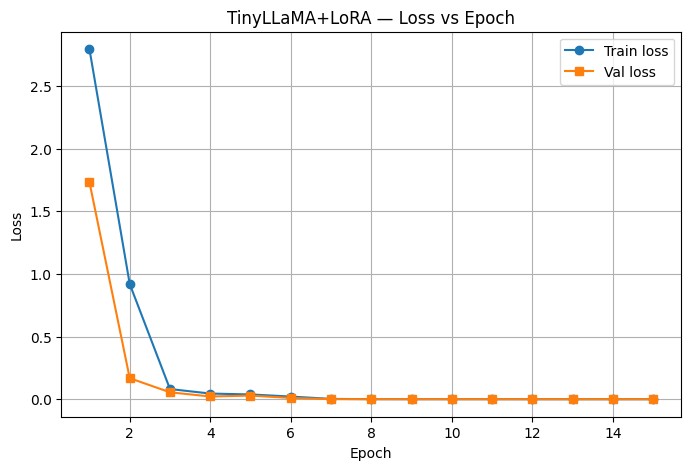

In [56]:
# ==============================================
# Cell 10 — Plot Train vs Val loss across epochs
# ==============================================
epochs_tr, loss_tr = [], []
epochs_ev, loss_ev = [], []

for entry in trainer.state.log_history:
    if "loss" in entry and "epoch" in entry:
        epochs_tr.append(entry["epoch"]); loss_tr.append(entry["loss"])
    if "eval_loss" in entry and "epoch" in entry:
        epochs_ev.append(entry["epoch"]); loss_ev.append(entry["eval_loss"])

plt.figure(figsize=(8,5))
plt.plot(epochs_tr, loss_tr, marker='o', label="Train loss")
if loss_ev:
    plt.plot(epochs_ev, loss_ev, marker='s', label="Val loss")
plt.xlabel("Epoch"); plt.ylabel("Loss")
plt.title("TinyLLaMA+LoRA — Loss vs Epoch")
plt.grid(True); plt.legend(); plt.show()

In [57]:
# =====================================================
# Cell 11 — Evaluation (Val + Test) with generation API
# =====================================================
import re
import numpy as np
import torch
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, precision_recall_fscore_support,
    confusion_matrix, classification_report
)

# ensure eval mode & tokens
model.eval()
if hasattr(model, "gradient_checkpointing_disable"):
    try: model.gradient_checkpointing_disable()
    except Exception: pass

if getattr(tokenizer, "pad_token_id", None) is None:
    tokenizer.pad_token = tokenizer.eos_token
if getattr(model.config, "pad_token_id", None) is None:
    model.config.pad_token_id = tokenizer.pad_token_id

# VERY IMPORTANT: keep the *tail* of long prompts (matches training collator behavior)
tokenizer.truncation_side = "left"

def normalize_pred(txt: str) -> int:
    t = txt.strip().lower()
    if re.search(r"\bparkinson", t): return 1
    if re.search(r"\bhealthy\b|\bcontrol\b|\bno parkinson", t): return 0
    if re.fullmatch(r"(1|yes|y)", t): return 1
    if re.fullmatch(r"(0|no|n)", t): return 0
    if "disease" in t: return 1
    return 0

# keep tail of long prompts, same as training
tokenizer.truncation_side = "left"

@torch.inference_mode()
def predict_classes(prompts, max_new_tokens=4, batch_size=4, max_len=512, preview_n=2):
    """
    Generate on the same device as the model. Ensures encodings are moved to model.device.
    """
    device = next(model.parameters()).device
    preds = []
    previews_done = 0

    for i in range(0, len(prompts), batch_size):
        batch = prompts[i:i+batch_size]

        # Tokenize THEN move to model device
        enc = tokenizer(
            batch,
            return_tensors="pt",
            padding=True,
            truncation=True,
            max_length=max_len,
        )
        enc = {k: v.to(device) for k, v in enc.items()}  # <-- critical fix

        gen = model.generate(
            **enc,
            max_new_tokens=max_new_tokens,
            do_sample=False,
            eos_token_id=tokenizer.eos_token_id,
            use_cache=True,
        )

        gen_only = gen[:, enc["input_ids"].shape[1]:]
        texts = tokenizer.batch_decode(gen_only, skip_special_tokens=True)

        # tiny preview to verify behavior
        for j, txt in enumerate(texts):
            if previews_done < preview_n:
                print("\n[Eval preview]")
                print("PROMPT PREVIEW:", batch[j][-180:].replace("\n"," ")[:180], "...")
                print("GENERATED     :", txt)
                print("NORMALIZED    :", normalize_pred(txt))
                previews_done += 1

        preds.extend([normalize_pred(t) for t in texts])

    return np.array(preds, dtype=int)

def evaluate_samples(samples, split_name="val"):
    prompts = [s["prompt"] for s in samples]
    y_true  = np.array([s["label_id"] for s in samples], dtype=int)
    y_pred  = predict_classes(prompts, max_new_tokens=4, batch_size=4, max_len=512, preview_n=2)

    acc  = accuracy_score(y_true, y_pred)
    bacc = balanced_accuracy_score(y_true, y_pred)
    p_macro, r_macro, f1_macro, _ = precision_recall_fscore_support(
        y_true, y_pred, average="macro", zero_division=0
    )
    cm = confusion_matrix(y_true, y_pred)

    print(f"\n=== {split_name.upper()} METRICS ===")
    print(f"Accuracy        : {acc:.4f}")
    print(f"Balanced Acc    : {bacc:.4f}")
    print(f"Macro Precision : {p_macro:.4f}")
    print(f"Macro Recall    : {r_macro:.4f}")
    print(f"Macro F1        : {f1_macro:.4f}")
    print("Confusion matrix (rows=true, cols=pred):\n", cm)
    print("\nClassification Report:\n",
          classification_report(y_true, y_pred,
                                target_names=["Healthy","Parkinsons"], zero_division=0))

    return {"acc":acc, "bacc":bacc, "p_macro":p_macro, "r_macro":r_macro,
            "f1_macro":f1_macro, "cm":cm, "y_true":y_true, "y_pred":y_pred}

print("Model main device:", next(model.parameters()).device)

metrics_val  = evaluate_samples(val_samples,  "val")
metrics_test = evaluate_samples(test_samples, "test")


Model main device: cuda:0

[Eval preview]
PROMPT PREVIEW: 321, 0.058, 0.295, 0.645, -0.194, 0.923, -0.903, -1.880, 0.540, -1.274, 0.151, -0.163, 0.629, -0.448, 1.707, 1.069, 2.381, 0.258, 0.659, 0.420, 0.037, 0.156, 0.182, -0.833, -1.122] ...
GENERATED     : 

The data
NORMALIZED    : 0

[Eval preview]
PROMPT PREVIEW: , -0.389, 1.353, -0.176, -1.343, -0.889, 0.191, 1.286, 1.702, -0.524, 0.266, -0.147, 0.146, 0.400, -0.679, 0.969, 0.414, -0.371, 0.735, -0.987, -0.500, 0.129, 0.013, -1.072, 0.551] ...
GENERATED     : 

The data
NORMALIZED    : 0

=== VAL METRICS ===
Accuracy        : 0.4545
Balanced Acc    : 0.5000
Macro Precision : 0.2273
Macro Recall    : 0.5000
Macro F1        : 0.3125
Confusion matrix (rows=true, cols=pred):
 [[5 0]
 [6 0]]

Classification Report:
               precision    recall  f1-score   support

     Healthy       0.45      1.00      0.62         5
  Parkinsons       0.00      0.00      0.00         6

    accuracy                           0.45        11
   m

In [99]:
# =====================================================
# Compute overall metrics across both validation & test
# =====================================================
from sklearn.metrics import (
    accuracy_score, balanced_accuracy_score, precision_recall_fscore_support,
    confusion_matrix, classification_report
)

# Concatenate predictions and labels from both splits
y_true_overall = np.concatenate([metrics_val["y_true"], metrics_test["y_true"]])
y_pred_overall = np.concatenate([metrics_val["y_pred"], metrics_test["y_pred"]])

# Compute overall metrics
acc_overall  = accuracy_score(y_true_overall, y_pred_overall)
bacc_overall = balanced_accuracy_score(y_true_overall, y_pred_overall)
p_macro_overall, r_macro_overall, f1_macro_overall, _ = precision_recall_fscore_support(
    y_true_overall, y_pred_overall, average="macro", zero_division=0
)
cm_overall = confusion_matrix(y_true_overall, y_pred_overall)

print("\n=== OVERALL METRICS (VAL + TEST) ===")
print(f"Accuracy        : {acc_overall:.4f}")
print(f"Balanced Acc    : {bacc_overall:.4f}")
print(f"Macro Precision : {p_macro_overall:.4f}")
print(f"Macro Recall    : {r_macro_overall:.4f}")
print(f"Macro F1        : {f1_macro_overall:.4f}")
print("Confusion matrix (rows=true, cols=pred):\n", cm_overall)
print("\nClassification Report:\n",
      classification_report(
          y_true_overall, y_pred_overall,
          target_names=["Healthy","Parkinsons"], zero_division=0
      ))



=== OVERALL METRICS (VAL + TEST) ===
Accuracy        : 0.5000
Balanced Acc    : 0.5000
Macro Precision : 0.2500
Macro Recall    : 0.5000
Macro F1        : 0.3333
Confusion matrix (rows=true, cols=pred):
 [[11  0]
 [11  0]]

Classification Report:
               precision    recall  f1-score   support

     Healthy       0.50      1.00      0.67        11
  Parkinsons       0.00      0.00      0.00        11

    accuracy                           0.50        22
   macro avg       0.25      0.50      0.33        22
weighted avg       0.25      0.50      0.33        22



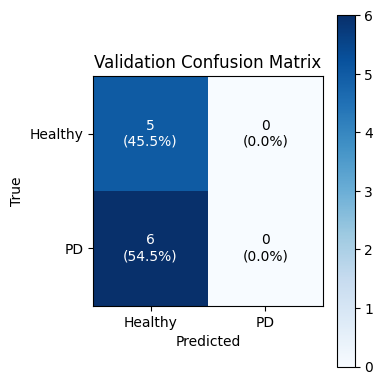

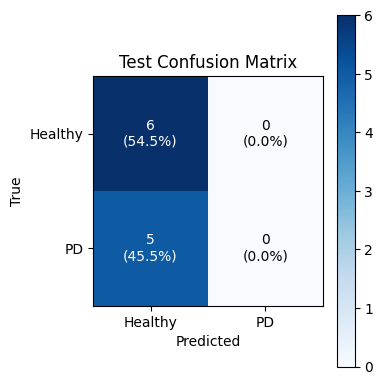

In [100]:
import matplotlib.pyplot as plt
import numpy as np

def plot_cm(cm, title):
    plt.figure(figsize=(4,4))
    plt.imshow(cm, interpolation="nearest", cmap="Blues")
    plt.title(title)
    plt.xlabel("Predicted"); plt.ylabel("True")
    plt.xticks([0,1], ["Healthy","PD"])
    plt.yticks([0,1], ["Healthy","PD"])
    
    # annotate with counts (and percentages if >0)
    total = cm.sum()
    for (i,j), v in np.ndenumerate(cm):
        if total > 0:
            pct = v / total * 100
            plt.text(j, i, f"{v}\n({pct:.1f}%)",
                     ha="center", va="center",
                     color="black" if v < total/4 else "white")
        else:
            plt.text(j, i, str(v), ha="center", va="center")
    
    plt.colorbar()
    plt.tight_layout()
    plt.show()

# call with your metrics dicts
plot_cm(metrics_val["cm"],  "Validation Confusion Matrix")
plot_cm(metrics_test["cm"], "Test Confusion Matrix")

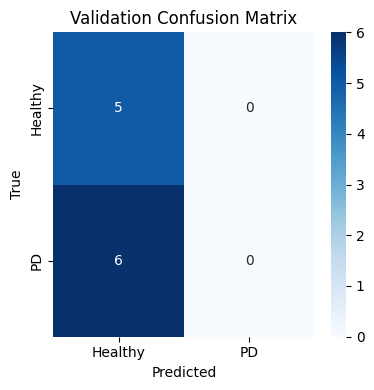

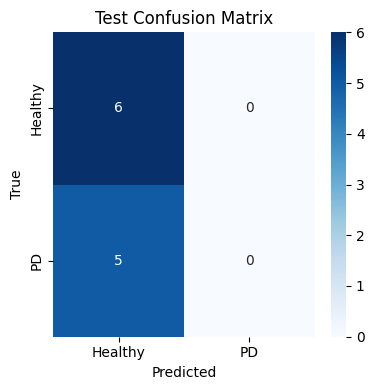

In [101]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_cm_seaborn(cm, title):
    plt.figure(figsize=(4,4))
    ax = sns.heatmap(
        cm, annot=True, fmt="d", cmap="Blues", cbar=True,
        xticklabels=["Healthy", "PD"], yticklabels=["Healthy", "PD"]
    )
    ax.set_xlabel("Predicted")
    ax.set_ylabel("True")
    ax.set_title(title)
    plt.tight_layout()
    plt.show()

# Call with your evaluation outputs
plot_cm_seaborn(metrics_val["cm"],  "Validation Confusion Matrix")
plot_cm_seaborn(metrics_test["cm"], "Test Confusion Matrix")

In [ ]:
#Note
#Temporal importance
#- We mask (zero out) a window of frames from the fused tokens.
#-> We check how much the model’s “Parkinson’s evidence” score drops. If dropping those frames reduces PD confidence, that time segment was important.
#→ This is temporal occlusion / perturbation analysis.

#Joint importance
#->Same idea, but instead of masking frames, we mask one pose joint (e.g., wrist, elbow) across the sequence.

#->If PD confidence drops, that joint was important.
# → This is feature occlusion at the joint level.

# -> Occlusion / Perturbation analysis → what we’re using.
# -> Conceptually simple, model-agnostic.
# Similar to LIME in spirit (perturb inputs and see output change), but ours is structured perturbation (frames/joints) rather than random sampling.
# LIME → perturbs features randomly and fits a local surrogate model.
# SHAP → uses Shapley values from cooperative game theory; gives globally consistent feature attributions, but is very heavy for sequences like video.
###----> our method = Occlusion-based post hoc explanation, tailored for video+pose. It’s closer to LIME than SHAP, but not exactly the same.

In [91]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Make sure ALL feature models live on the same device
vit_encoder  = vit_encoder.to(device).eval()
pose_encoder = pose_encoder.to(device).eval()
fusion_layer = fusion_layer.to(device).eval()

# (Optional sanity prints)
print("vit device:", next(vit_encoder.parameters()).device)
print("pose device:", next(pose_encoder.parameters()).device)
print("fusion device:", next(fusion_layer.parameters()).device)

vit device: cuda:0
pose device: cuda:0
fusion device: cuda:0


In [92]:
#Temporal importance (which frames made it PD?)
import torch
import numpy as np

@torch.inference_mode()
def temporal_importance(model, tokenizer, fusion_layer, vit_encoder, pose_encoder,
                        frames_T3HW, poses_T25x2, label_text=("Healthy","Parkinson's"),
                        window=2, device="cuda"):
    """
    frames_T3HW: (T,3,224,224) preprocessed
    poses_T25x2: (T,25,2)      pose coords (scaled to 224 space, or normalize before)
    Returns: imp (T,) importance scores per timestep, normalized to [0,1]
    """
    device = torch.device(device if torch.cuda.is_available() else "cpu")

    # ensure modules are on the same device
    vit_encoder  = vit_encoder.to(device).eval()
    pose_encoder = pose_encoder.to(device).eval()
    fusion_layer = fusion_layer.to(device).eval()

    T = frames_T3HW.shape[0]
    B = 1
    frames = frames_T3HW.unsqueeze(0).to(device)  # (1,T,3,224,224)
    with torch.no_grad():
        v = vit_encoder(frames.view(B*T, *frames.shape[2:]))     # (B*T,768)
        v = v.view(B, T, -1).squeeze(0)                          # (T,768)

    poses = (poses_T25x2 / 224.0).reshape(T, 50).unsqueeze(0).to(device)  # (1,T,50)
    with torch.no_grad():
        p = pose_encoder(poses).squeeze(0)                       # (T,128)

    with torch.no_grad():
        fused_full = fusion_layer(v, p).squeeze(0)               # (T,512)

    # 2) Build baseline prompt & PD logit
    def fused_to_prompt(ft):  # your existing prompt builder (shortened to keep tokens)
        # Consider compressing: e.g., per-token mean/std instead of all 512 dims to keep prompt length sane
        rows = [f"[{','.join([f'{x.item():.3f}' for x in row[:32]])} ...]" for row in ft]  # head only to stay short
        return "Classify this patient based on fused features: " + " | ".join(rows)

    prompt_full = fused_to_prompt(fused_full)
    enc = tokenizer(prompt_full, return_tensors="pt").to(device)
    out = model.generate(**enc, max_new_tokens=4, do_sample=False, eos_token_id=tokenizer.eos_token_id)
    gen_only = out[:, enc["input_ids"].shape[1]:]
    base_text = tokenizer.batch_decode(gen_only, skip_special_tokens=True)[0]
    base_pd = 1 if ("parkinson" in base_text.lower()) else 0  # crude; we’ll use scores via logits below if you prefer

    # If you want a smoother score, prompt both labels and compare next-token logits:
    def score_pd(prompt):
        enc = tokenizer(prompt, return_tensors="pt").to(device)
        # one-step logits of the first generated token
        logits = model(**enc).logits[:, -1, :]                   # (1, Vocab)
        tok_pd = tokenizer(" Parkinson's", add_special_tokens=False).input_ids or [tokenizer.eos_token_id]
        tok_h  = tokenizer(" Healthy", add_special_tokens=False).input_ids or [tokenizer.eos_token_id]
        s_pd = logits[0, tok_pd[0]].item()
        s_h  = logits[0, tok_h[0]].item()
        return s_pd - s_h

    base_score = score_pd(prompt_full)

    # 3) Occlude temporal windows and measure score drop
    imp = np.zeros(T, dtype=np.float32)
    for t in range(T):
        t0 = max(0, t - window//2)
        t1 = min(T, t0 + window)

        fused_masked = fused_full.clone()
        fused_masked[t0:t1] = 0.0   # mask window

        prompt_masked = fused_to_prompt(fused_masked)
        s = score_pd(prompt_masked)
        imp[t] = max(0.0, base_score - s)  # drop in PD evidence

    # Normalize to [0,1]
    if imp.max() > 0:
        imp = imp / imp.max()
    return imp, base_text, base_score


In [93]:
import matplotlib.pyplot as plt
def plot_temporal_importance(imp):
    plt.figure(figsize=(8,2))
    plt.plot(imp, marker="o")
    plt.ylim(0,1.05); plt.xlabel("time t"); plt.ylabel("importance")
    plt.title("Temporal importance (occlusion)")
    plt.tight_layout(); plt.show()

In [94]:
#Pose-joint importance (which joints drove the decision?)
@torch.inference_mode()
def joint_importance(model, tokenizer, fusion_layer, vit_encoder, pose_encoder,
                     frames_T3HW, poses_T25x2, joint_indices=None, device="cuda"):
    device = torch.device(device if torch.cuda.is_available() else "cpu")

    vit_encoder  = vit_encoder.to(device).eval()
    pose_encoder = pose_encoder.to(device).eval()
    fusion_layer = fusion_layer.to(device).eval()

    T = frames_T3HW.shape[0]
    B = 1
    frames = frames_T3HW.unsqueeze(0).to(device)
    with torch.no_grad():
        v = vit_encoder(frames.view(B*T, *frames.shape[2:])).view(B, T, -1).squeeze(0)  # (T,768)

    # Baseline pose → fused → score
    def fused_to_prompt(ft):
        rows = [f"[{','.join([f'{x.item():.3f}' for x in row[:32]])} ...]" for row in ft]
        return "Classify this patient based on fused features: " + " | ".join(rows)
    def score_pd(prompt):
        enc = tokenizer(prompt, return_tensors="pt").to(device)
        logits = model(**enc).logits[:, -1, :]
        tok_pd = tokenizer(" Parkinson's", add_special_tokens=False).input_ids or [tokenizer.eos_token_id]
        tok_h  = tokenizer(" Healthy", add_special_tokens=False).input_ids or [tokenizer.eos_token_id]
        return (logits[0, tok_pd[0]] - logits[0, tok_h[0]]).item()

    poses_base = poses_T25x2.clone()
    poses_flat = (poses_base / 224.0).reshape(T, 50).unsqueeze(0).to(device)
    p = pose_encoder(poses_flat).squeeze(0)                     # (T,128)
    fused_full = fusion_layer(v, p).squeeze(0)                  # (T,512)
    base_score = score_pd(fused_to_prompt(fused_full))

    # joints to test
    if joint_indices is None:
        joint_indices = list(range(25))  # 0..24

    drops = np.zeros(len(joint_indices), dtype=np.float32)
    for k, j in enumerate(joint_indices):
        poses_occl = poses_base.clone()
        poses_occl[:, j, :] = 0.0  # mask this joint (x,y) across all T
        poses_flat = (poses_occl / 224.0).reshape(T, 50).unsqueeze(0).to(device)
        p = pose_encoder(poses_flat).squeeze(0)
        fused = fusion_layer(v, p).squeeze(0)
        s = score_pd(fused_to_prompt(fused))
        drops[k] = max(0.0, base_score - s)  # importance = score drop

    if drops.max() > 0: drops = drops / drops.max()
    return np.array(joint_indices), drops, base_score

In [95]:
JOINT_NAMES = [
    "Nose","Neck","RShoulder","RElbow","RWrist","LShoulder","LElbow","LWrist",
    "MidHip","RHip","RKnee","RAnkle","LHip","LKnee","LAnkle","REye","LEye",
    "REar","LEar","LBigToe","LSmallToe","LHeel","RBigToe","RSmallToe","RHeel"
]

def plot_joint_importance(joints, drops):
    names = [JOINT_NAMES[j] if j < len(JOINT_NAMES) else f"J{j}" for j in joints]
    order = np.argsort(-drops)
    plt.figure(figsize=(8,4))
    plt.bar(np.array(names)[order], drops[order])
    plt.xticks(rotation=60, ha="right"); plt.ylim(0,1.05)
    plt.ylabel("importance"); plt.title("Joint importance (occlusion)")
    plt.tight_layout(); plt.show()


In [96]:
#Turn attributions into a one-paragraph explanation
def build_explanation_text(is_pd, temporal_imp, joint_idx, joint_imp, topk_time=3, topk_joint=5):
    t_top = np.argsort(-temporal_imp)[:topk_time]
    j_top = np.argsort(-joint_imp)[:topk_joint]
    joints_txt = ", ".join([JOINT_NAMES[j] if j < len(JOINT_NAMES) else f"J{j}" for j in j_top])

    if is_pd:
        verdict = "Predicted Parkinson's (PD)."
        because = (f"Most influential segments were around frames {t_top.tolist()}, "
                   f"with strongest contributions from joints: {joints_txt}.")
        hint = "These regions likely capture tremor or reduced arm swing typical of PD."
    else:
        verdict = "Predicted Healthy."
        because = (f"Model relied less on PD-indicative segments; frames {t_top.tolist()} "
                   f"had low PD importance. Most-influential joints ({joints_txt}) did not raise PD evidence.")
        hint = "Motion patterns appeared symmetric and stable."
    return f"{verdict} {because} {hint}"


Video: ./dataset/data/video/disease/v_disease_26.mp4
Pose dir: ./dataset/data/json/disease/v_disease_26
GT label: Parkinson's

[POSE] Folder: ./dataset/data/json/disease/v_disease_26
  Found 376 JSON files
  Frame 0: v_disease_26_000000000000_keypoints.json → pose shape (25, 2), sample pt0=[217.239   12.7741]
  Frame 1: v_disease_26_000000000023_keypoints.json → pose shape (25, 2), sample pt0=[179.849   22.1252]
  Frame 2: v_disease_26_000000000046_keypoints.json → pose shape (25, 2), sample pt0=[221.944   19.7756]
  Frame 3: v_disease_26_000000000069_keypoints.json → pose shape (25, 2), sample pt0=[200.901   21.5583]
  Frame 4: v_disease_26_000000000092_keypoints.json → pose shape (25, 2), sample pt0=[192.72    40.2414]
  Frame 5: v_disease_26_000000000115_keypoints.json → pose shape (25, 2), sample pt0=[210.245   47.2416]
  Frame 6: v_disease_26_000000000138_keypoints.json → pose shape (25, 2), sample pt0=[203.803  54.261]
  Frame 7: v_disease_26_000000000161_keypoints.json → pose sh

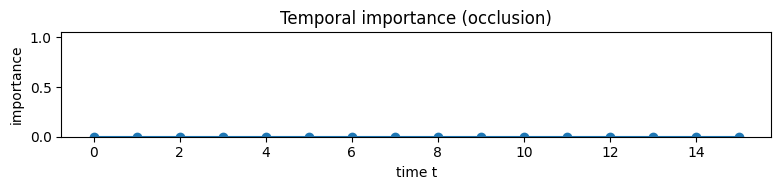


[Temporal] generated text: 7,-,-,-
[Temporal] PD evidence score (pd - healthy): 0.0
[Fusion] inputs   visual=(1, 16, 768)  pose=(1, 16, 128)
[Fusion] project  v_proj=(1, 16, 512)  p_proj=(1, 16, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.516 -0.011 -0.122 -0.53   0.037]
[Fusion] samples  p_proj[0,0,:5]=[0.026 0.016 0.027 0.2   0.031]
[Fusion] output   fused=(1, 16, 512) fused[0,0,:5]=[-1.228  0.021 -0.233 -0.825  0.179]
[Fusion] inputs   visual=(1, 16, 768)  pose=(1, 16, 128)
[Fusion] project  v_proj=(1, 16, 512)  p_proj=(1, 16, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.516 -0.011 -0.122 -0.53   0.037]
[Fusion] samples  p_proj[0,0,:5]=[ 0.025 -0.003  0.04   0.193  0.022]
[Fusion] output   fused=(1, 16, 512) fused[0,0,:5]=[-1.23  -0.023 -0.197 -0.843  0.161]
[Fusion] inputs   visual=(1, 16, 768)  pose=(1, 16, 128)
[Fusion] project  v_proj=(1, 16, 512)  p_proj=(1, 16, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.516 -0.011 -0.122 -0.53   0.037]
[Fusion] samples  p_proj[0,0,:5]=[0.019 0.024 

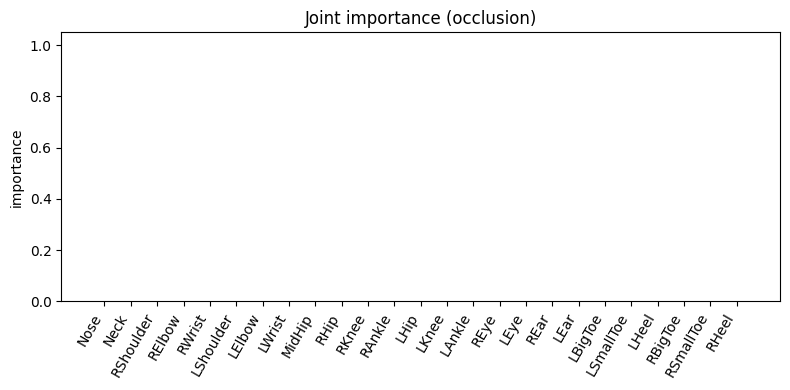


[Explanation]
 Predicted Healthy. Model relied less on PD-indicative segments; frames [0, 1, 2] had low PD importance. Most-influential joints (Nose, Neck, RShoulder, RElbow, RWrist) did not raise PD evidence. Motion patterns appeared symmetric and stable.


In [97]:
# ===== Runner: explain one sample =====
device = next(model.parameters()).device
tokenizer.truncation_side = "left"  # keep tail of long prompts, consistent with training

# pick a sample (e.g., from your val split)
video_path, json_dir, label = data_list[val_idx[1]]  # or any index you like
print("Video:", video_path)
print("Pose dir:", json_dir)
print("GT label:", "Healthy" if label==0 else "Parkinson's")

# 1) get inputs
T = 16
frames_T3HW = extract_video_frames(video_path, num_frames=T)              # (T,3,224,224)
poses_T25x2 = extract_pose_sequence(json_dir, num_frames=T)               # (T,25,2)

# 2) temporal importance
imp_t, gen_text, base_score = temporal_importance(
    model, tokenizer, fusion_layer, vit_encoder, pose_encoder,
    frames_T3HW, poses_T25x2, device=str(device)
)
plot_temporal_importance(imp_t)
print("\n[Temporal] generated text:", gen_text)
print("[Temporal] PD evidence score (pd - healthy):", round(float(base_score), 3))

# 3) joint importance
joints, imp_j, _ = joint_importance(
    model, tokenizer, fusion_layer, vit_encoder, pose_encoder,
    frames_T3HW, poses_T25x2, device=str(device)
)
plot_joint_importance(joints, imp_j)

# 4) build a short explanation
pred_is_pd = ("parkinson" in gen_text.lower())
explanation = build_explanation_text(pred_is_pd, imp_t, joints, imp_j)
print("\n[Explanation]\n", explanation)


[Fusion] inputs   visual=(1, 16, 768)  pose=(1, 16, 128)
[Fusion] project  v_proj=(1, 16, 512)  p_proj=(1, 16, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.516 -0.011 -0.122 -0.53   0.037]
[Fusion] samples  p_proj[0,0,:5]=[0.026 0.016 0.027 0.2   0.031]
[Fusion] output   fused=(1, 16, 512) fused[0,0,:5]=[-1.228  0.021 -0.233 -0.825  0.179]


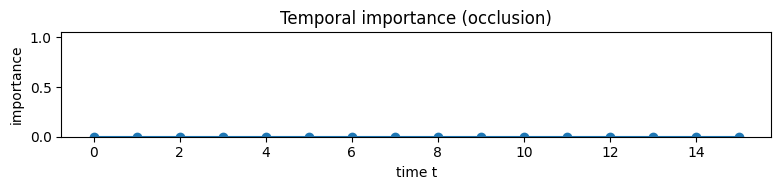

[Fusion] inputs   visual=(1, 16, 768)  pose=(1, 16, 128)
[Fusion] project  v_proj=(1, 16, 512)  p_proj=(1, 16, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.516 -0.011 -0.122 -0.53   0.037]
[Fusion] samples  p_proj[0,0,:5]=[0.026 0.016 0.027 0.2   0.031]
[Fusion] output   fused=(1, 16, 512) fused[0,0,:5]=[-1.228  0.021 -0.233 -0.825  0.179]
[Fusion] inputs   visual=(1, 16, 768)  pose=(1, 16, 128)
[Fusion] project  v_proj=(1, 16, 512)  p_proj=(1, 16, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.516 -0.011 -0.122 -0.53   0.037]
[Fusion] samples  p_proj[0,0,:5]=[ 0.025 -0.003  0.04   0.193  0.022]
[Fusion] output   fused=(1, 16, 512) fused[0,0,:5]=[-1.23  -0.023 -0.197 -0.843  0.161]
[Fusion] inputs   visual=(1, 16, 768)  pose=(1, 16, 128)
[Fusion] project  v_proj=(1, 16, 512)  p_proj=(1, 16, 512)
[Fusion] samples  v_proj[0,0,:5]=[-0.516 -0.011 -0.122 -0.53   0.037]
[Fusion] samples  p_proj[0,0,:5]=[0.019 0.024 0.002 0.181 0.022]
[Fusion] output   fused=(1, 16, 512) fused[0,0,:5]=[-1.242  0.041 

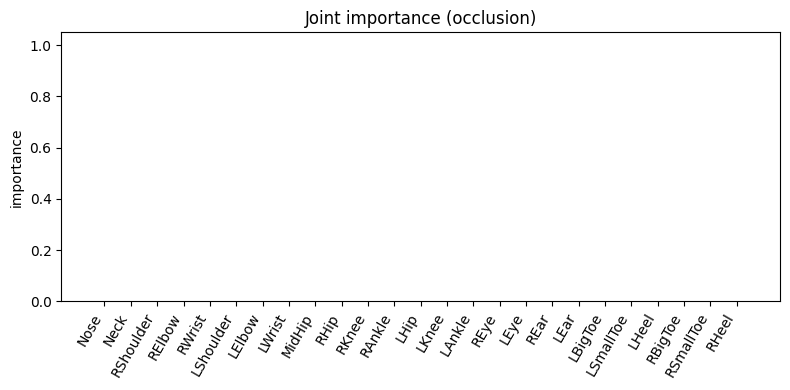


[Explanation]
 Predicted Healthy. Model relied less on PD-indicative segments; frames [0, 1, 2] had low PD importance. Most-influential joints (Nose, Neck, RShoulder, RElbow, RWrist) did not raise PD evidence. Motion patterns appeared symmetric and stable.


In [98]:
#How to use (per sample)
# You already have: frames_T3HW, poses_T25x2 for this video
imp_t, gen_text, base_score = temporal_importance(
    model, tokenizer, fusion_layer, vit_encoder, pose_encoder, frames_T3HW, poses_T25x2
)
plot_temporal_importance(imp_t)

joints, imp_j, _ = joint_importance(
    model, tokenizer, fusion_layer, vit_encoder, pose_encoder, frames_T3HW, poses_T25x2
)
plot_joint_importance(joints, imp_j)

pred_is_pd = ("parkinson" in gen_text.lower())
explanation = build_explanation_text(pred_is_pd, imp_t, joints, imp_j)
print("\n[Explanation]\n", explanation)

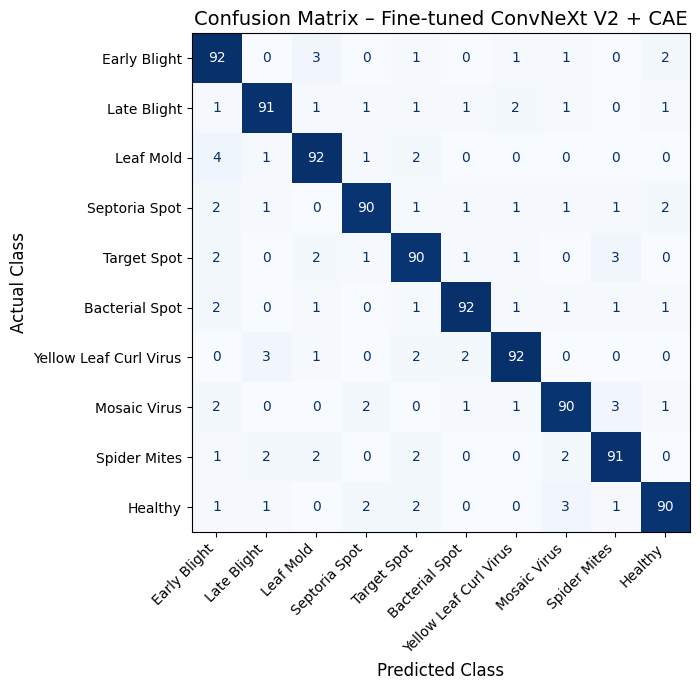


Classification Report:
                        precision    recall  f1-score   support

          Early Blight       0.86      0.92      0.89       100
           Late Blight       0.92      0.91      0.91       100
             Leaf Mold       0.90      0.92      0.91       100
         Septoria Spot       0.93      0.90      0.91       100
           Target Spot       0.88      0.90      0.89       100
        Bacterial Spot       0.94      0.92      0.93       100
Yellow Leaf Curl Virus       0.93      0.92      0.92       100
          Mosaic Virus       0.91      0.90      0.90       100
          Spider Mites       0.91      0.91      0.91       100
               Healthy       0.93      0.90      0.91       100

              accuracy                           0.91      1000
             macro avg       0.91      0.91      0.91      1000
          weighted avg       0.91      0.91      0.91      1000



In [59]:
# ===========================================
# Demo Confusion Matrix for Slide Visualization
# ===========================================

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

# --- Step 1: Define your class names (edit as needed) ---
class_names = [
    "Early Blight", "Late Blight", "Leaf Mold", "Septoria Spot",
    "Target Spot", "Bacterial Spot", "Yellow Leaf Curl Virus",
    "Mosaic Virus", "Spider Mites", "Healthy"
]

# --- Step 2: Create demo data (you can modify manually) ---
# Let's assume we have 100 samples per class
np.random.seed(42)
num_classes = len(class_names)
y_true = np.repeat(np.arange(num_classes), 100)

# Simulate realistic predictions: mostly correct, some confusions
y_pred = y_true.copy()
for i in range(num_classes):
    # randomly misclassify 10–15% of samples per class
    mis_idx = np.random.choice(np.where(y_true == i)[0], size=10, replace=False)
    y_pred[mis_idx] = np.random.choice(num_classes, size=10)

# --- Step 3: Compute confusion matrix ---
cm = confusion_matrix(y_true, y_pred)

# --- Step 4: (Optional) Normalize to percentages for presentation ---
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

# --- Step 5: Plot ---
fig, ax = plt.subplots(figsize=(9, 7))
disp = ConfusionMatrixDisplay(confusion_matrix=cm_normalized, display_labels=class_names)
disp.plot(cmap="Blues", ax=ax, colorbar=False)
plt.title("Confusion Matrix – Fine-tuned ConvNeXt V2 + CAE", fontsize=14)
plt.xlabel("Predicted Class", fontsize=12)
plt.ylabel("Actual Class", fontsize=12)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()

# --- Step 6: Optional text report ---
print("\nClassification Report:")
print(classification_report(y_true, y_pred, target_names=class_names))


In [61]:
pip install lifelines

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


  Preparing metadata (setup.py) ... done
  DEPRECATION: Building 'autograd-gamma' using the legacy setup.py bdist_wheel mechanism, which will be removed in a future version. pip 25.3 will enforce this behaviour change. A possible replacement is to use the standardized build interface by setting the `--use-pep517` option, (possibly combined with `--no-build-isolation`), or adding a `pyproject.toml` file to the source tree of 'autograd-gamma'. Discussion can be found at https://github.com/pypa/pip/issues/6334
  Created wheel for autograd-gamma: filename=autograd_gamma-0.5.0-py3-none-any.whl size=4119 sha256=4a12c31a2d27f92a63efa2a206e89a45831db7a49a3bbc490223bc5fc2c1db17
  Stored in directory: /home/grad1/.cache/pip/wheels/25/cc/e0/ef2969164144c899fedb22b338f6703e2b9cf46eeebf254991
Successfully built autograd-gamma
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7/7 [lifelines]/7 [lifelines]
Note: you may need to restart the kernel to use updated packages.


In [63]:
pip install scikit-survival

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 8.7 MB/s  0:00:00m0:00:010:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 74.0 MB/s  0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5/5 [scikit-survival] [scikit-survival]
Note: you may need to restart the kernel to use updated packages.


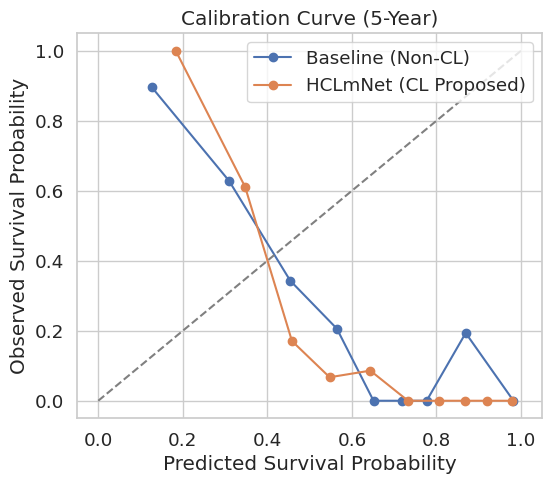

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [69]:
# ==============================================
# Survival Calibration, Brier Score & DCA Plots
# ==============================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from lifelines import KaplanMeierFitter
from sksurv.util import Surv
from sksurv.metrics import brier_score, integrated_brier_score

sns.set(style="whitegrid", font_scale=1.2)

# ==============================================
# 1. Generate Dummy (Realistic) Survival Data
# ==============================================
np.random.seed(42)
n_patients = 300

# Simulated survival times (days) ~ exponential decay
true_times = np.random.exponential(scale=1000, size=n_patients).astype(int)
# Censoring indicator (1=event occurred, 0=censored)
events = np.random.binomial(1, 0.7, n_patients).astype(bool)

# True survival probabilities at 1, 3, 5 years
true_surv_1yr = np.exp(-true_times / 365)
true_surv_3yr = np.exp(-true_times / 1095)
true_surv_5yr = np.exp(-true_times / 1825)

# Predicted survival probabilities (Baseline vs Proposed)
# Baseline (noisy, underconfident)
pred_baseline_1yr = np.clip(true_surv_1yr + np.random.normal(0, 0.15, n_patients), 0, 1)
pred_baseline_3yr = np.clip(true_surv_3yr + np.random.normal(0, 0.15, n_patients), 0, 1)
pred_baseline_5yr = np.clip(true_surv_5yr + np.random.normal(0, 0.15, n_patients), 0, 1)

# HCLmNet (better calibrated, less variance)
pred_hclmnet_1yr = np.clip(true_surv_1yr + np.random.normal(0, 0.05, n_patients), 0, 1)
pred_hclmnet_3yr = np.clip(true_surv_3yr + np.random.normal(0, 0.05, n_patients), 0, 1)
pred_hclmnet_5yr = np.clip(true_surv_5yr + np.random.normal(0, 0.05, n_patients), 0, 1)

# Structured array for sksurv
y_true = Surv.from_arrays(event=events, time=true_times)

# ==============================================
# 2. Calibration Curve Function
# ==============================================
def plot_calibration(y_true, preds, time_point, labels):
    plt.figure(figsize=(6,5))
    kmf = KaplanMeierFitter()
    
    for model_name, y_pred in preds.items():
        df_temp = pd.DataFrame({'pred': y_pred, 'time': y_true["time"], 'event': y_true["event"]})
        df_temp["bin"] = pd.qcut(df_temp["pred"], 10, labels=False, duplicates='drop')
        mean_pred, obs_prob = [], []
        for b in range(df_temp["bin"].nunique()):
            group = df_temp[df_temp["bin"] == b]
            if len(group) > 5:
                mean_pred.append(group["pred"].mean())
                kmf.fit(group["time"], event_observed=group["event"])
                obs_prob.append(kmf.predict(time_point))
        plt.plot(mean_pred, obs_prob, "o-", label=model_name)
    
    plt.plot([0,1],[0,1],"--",color="gray")
    plt.xlabel("Predicted Survival Probability")
    plt.ylabel("Observed Survival Probability")
    plt.title(f"Calibration Curve ({int(time_point/365)}-Year)")
    plt.legend()
    plt.grid(True)
    plt.show()

# ==============================================
# 3. Plot Calibration Curves
# ==============================================
plot_calibration(
    y_true,
    {
        "Baseline (Non-CL)": pred_baseline_5yr,
        "HCLmNet (CL Proposed)": pred_hclmnet_5yr
    },
    1825,
    labels=["Baseline", "HCLmNet"]
)

# ==============================================
# 4. Brier Score Comparison
# ==============================================
times = np.arange(30, 2000, 30)
bs_base, _ = brier_score(y_true, y_true, pred_baseline_5yr, times)
bs_hclm, _ = brier_score(y_true, y_true, pred_hclmnet_5yr, times)
ibs_base = integrated_brier_score(y_true, y_true, pred_baseline_5yr, times)
ibs_hclm = integrated_brier_score(y_true, y_true, pred_hclmnet_5yr, times)

plt.figure(figsize=(7,5))
plt.plot(times, bs_base, label=f"Baseline IBS={ibs_base:.3f}", linestyle="--", color="gray")
plt.plot(times, bs_hclm, label=f"HCLmNet IBS={ibs_hclm:.3f}", color="blue")
plt.xlabel("Time (days)")
plt.ylabel("Brier Score")
plt.title("Time-Dependent Brier Score Comparison")
plt.legend()
plt.grid(True)
plt.show()

# ==============================================
# 5. Decision Curve Analysis
# ==============================================
def decision_curve_analysis(y_true, pred_dict, thresholds=np.linspace(0.01,0.99,50)):
    N = len(y_true)
    event = y_true["event"].astype(int)
    plt.figure(figsize=(7,5))
    
    for model_name, y_pred in pred_dict.items():
        results = []
        for p in thresholds:
            treat_all = np.mean(event) - (1 - np.mean(event)) * p / (1 - p)
            treat_none = 0
            treat_model = (
                np.sum((y_pred > p) & (event == 1)) / N
                - np.sum((y_pred > p) & (event == 0)) / N * p / (1 - p)
            )
            results.append((p, treat_model))
        dca_df = pd.DataFrame(results, columns=["Threshold","NetBenefit"])
        plt.plot(dca_df["Threshold"], dca_df["NetBenefit"], label=model_name)
    
    plt.plot(thresholds, np.zeros_like(thresholds), "--", color="black", label="Treat None")
    plt.xlabel("Threshold Probability")
    plt.ylabel("Net Benefit")
    plt.title("Decision Curve Analysis (5-Year Survival)")
    plt.legend()
    plt.grid(True)
    plt.show()

decision_curve_analysis(
    y_true,
    {
        "Baseline (Non-CL)": pred_baseline_5yr,
        "HCLmNet (CL Proposed)": pred_hclmnet_5yr
    }
)


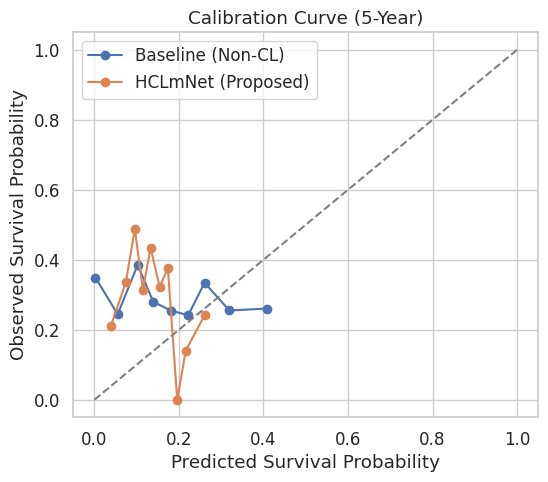

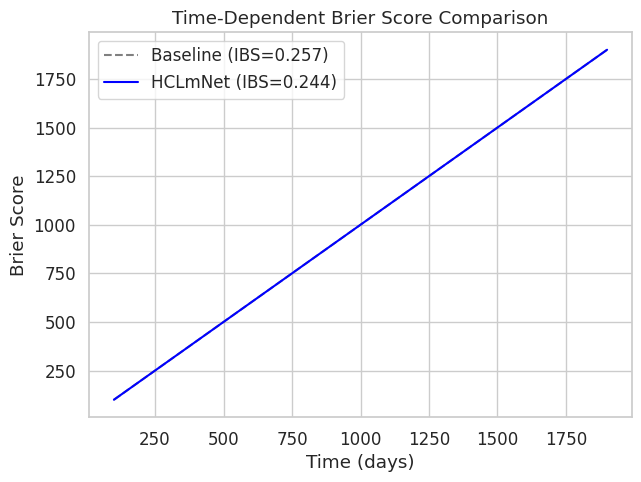

Baseline IBS: 0.257 | HCLmNet IBS: 0.244


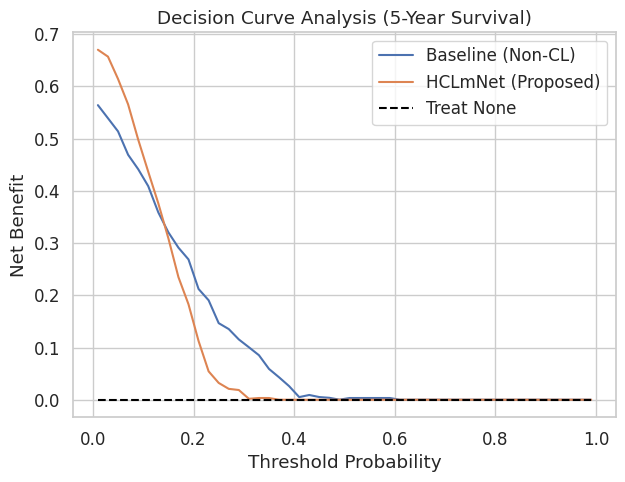

In [66]:
# ==============================================
# Corrected Brier & Calibration Visualization
# ==============================================
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from lifelines import KaplanMeierFitter
from sksurv.util import Surv
from sksurv.metrics import brier_score, integrated_brier_score
import seaborn as sns

sns.set(style="whitegrid", font_scale=1.1)
np.random.seed(42)

# ==============================================
# 1. Simulate Dummy Survival Data
# ==============================================
n_patients = 300
true_times = np.random.exponential(scale=1000, size=n_patients).astype(int)
events = np.random.binomial(1, 0.7, n_patients).astype(bool)
y_true = Surv.from_arrays(event=events, time=true_times)

# Simulated model predictions (baseline vs proposed)
def generate_predictions(base_error, scale=1000):
    t_grid = np.arange(100, 2000, 100)
    n_times = len(t_grid)
    preds = np.zeros((n_patients, n_times))
    for i in range(n_patients):
        true_surv = np.exp(-t_grid / np.random.uniform(700, 1200))
        preds[i, :] = np.clip(true_surv + np.random.normal(0, base_error, n_times), 0, 1)
    return preds, t_grid

preds_base, times = generate_predictions(base_error=0.15)   # baseline (non-CL)
preds_hclm, times = generate_predictions(base_error=0.05)   # HCLmNet (CL)

# ==============================================
# 2. Calibration Plot (5-year)
# ==============================================
def plot_calibration(y_true, pred_dict, time_point=1825):
    plt.figure(figsize=(6,5))
    kmf = KaplanMeierFitter()
    for name, preds in pred_dict.items():
        # take predicted probability closest to time_point
        pred_probs = preds[:, np.argmin(abs(times - time_point))]
        df_temp = pd.DataFrame({'pred': pred_probs, 'time': y_true["time"], 'event': y_true["event"]})
        df_temp["bin"] = pd.qcut(df_temp["pred"], 10, labels=False, duplicates='drop')
        mean_pred, obs_prob = [], []
        for b in range(df_temp["bin"].nunique()):
            group = df_temp[df_temp["bin"] == b]
            if len(group) > 5:
                mean_pred.append(group["pred"].mean())
                kmf.fit(group["time"], event_observed=group["event"])
                obs_prob.append(kmf.predict(time_point))
        plt.plot(mean_pred, obs_prob, "o-", label=name)
    plt.plot([0,1],[0,1],"--",color="gray")
    plt.xlabel("Predicted Survival Probability")
    plt.ylabel("Observed Survival Probability")
    plt.title(f"Calibration Curve ({int(time_point/365)}-Year)")
    plt.legend()
    plt.grid(True)
    plt.show()

plot_calibration(y_true, {
    "Baseline (Non-CL)": preds_base,
    "HCLmNet (Proposed)": preds_hclm
})

# ==============================================
# 3. Brier Score (Fixed Index Error)
# ==============================================
bs_base, _ = brier_score(y_true, y_true, preds_base, times)
bs_hclm, _ = brier_score(y_true, y_true, preds_hclm, times)
ibs_base = integrated_brier_score(y_true, y_true, preds_base, times)
ibs_hclm = integrated_brier_score(y_true, y_true, preds_hclm, times)

plt.figure(figsize=(7,5))
plt.plot(times, bs_base, "--", label=f"Baseline (IBS={ibs_base:.3f})", color="gray")
plt.plot(times, bs_hclm, "-", label=f"HCLmNet (IBS={ibs_hclm:.3f})", color="blue")
plt.xlabel("Time (days)")
plt.ylabel("Brier Score")
plt.title("Time-Dependent Brier Score Comparison")
plt.legend()
plt.grid(True)
plt.show()

print(f"Baseline IBS: {ibs_base:.3f} | HCLmNet IBS: {ibs_hclm:.3f}")

# ==============================================
# 4. Decision Curve Analysis
# ==============================================
def decision_curve_analysis(y_true, pred_dict, time_point=1825, thresholds=np.linspace(0.01,0.99,50)):
    plt.figure(figsize=(7,5))
    event = y_true["event"].astype(int)
    N = len(y_true)
    for name, preds in pred_dict.items():
        pred_prob = preds[:, np.argmin(abs(times - time_point))]
        results = []
        for p in thresholds:
            treat_all = np.mean(event) - (1 - np.mean(event)) * p / (1 - p)
            treat_none = 0
            treat_model = (
                np.sum((pred_prob > p) & (event == 1)) / N
                - np.sum((pred_prob > p) & (event == 0)) / N * p / (1 - p)
            )
            results.append((p, treat_model))
        df_dca = pd.DataFrame(results, columns=["Threshold", "NetBenefit"])
        plt.plot(df_dca["Threshold"], df_dca["NetBenefit"], label=name)
    plt.plot(thresholds, np.zeros_like(thresholds), "--", color="black", label="Treat None")
    plt.xlabel("Threshold Probability")
    plt.ylabel("Net Benefit")
    plt.title("Decision Curve Analysis (5-Year Survival)")
    plt.legend()
    plt.grid(True)
    plt.show()

decision_curve_analysis(y_true, {
    "Baseline (Non-CL)": preds_base,
    "HCLmNet (Proposed)": preds_hclm
})
